In [1]:
!git clone https://github.com/moth-quantum/QuantumArtHack

fatal: destination path 'QuantumArtHack' already exists and is not an empty directory.


In [2]:
%cd QuantumArtHack

/content/QuantumArtHack


In [3]:
!pip install qiskit==2.0.0 matplotlib==3.10.1 ipykernel==6.29.5 pillow==11.1.0 ipywidgets==8.1.5 qiskit-aer==0.17.0 soundfile==0.13.1 pylatexenc==2.10 playsound3==3.2.2

In [4]:
import os
import sys

# Add the current directory (QuantumArtHack) to Python's path
sys.path.append(os.getcwd())

In [5]:
import QPIXL.helper as hlp
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.qiskit.qpixl_angs import cFRQIangs, decodeAngQPIXL
import qiskit
from qiskit import QuantumCircuit
from qiskit_aer import StatevectorSimulator, AerSimulator
import matplotlib.pyplot as plt
from matplotlib import animation
import numpy as np
from PIL import Image
from ipywidgets import interact
import ipywidgets as widgets
from IPython.display import display, clear_output
import os
from itertools import chain
import io
import math
# Removed: from scipy.fft import fwht, ifwht # No longer directly import these
from qiskit.circuit.library import QFT
import traceback

import warnings
import soundfile

warnings.filterwarnings("ignore")

backend = StatevectorSimulator(method="statevector")

# Quantum  Wave Interference Effect
Quantum Blending: Specific quantum gates (e.g., controlled rotations or entanglement operations) are applied to the quantum states. Unlike other effects, these operations are designed to directly or indirectly mix pixel values across the color channels, altering their relationships.

Preparation: You can specify your own image path in the IMAGE_PATH variable. The image is resized (preferably to a maximum dimension of 64x64 pixels, as larger sizes significantly increase quantum simulation time). Its color channels are then prepared for quantum processing.

Quantum Encoding: Pixel data is encoded into a quantum state using QPIXL's cFRQI.

Quantum Interference: A Quantum Fourier Transform (QFT) shifts the data to a frequency domain. rz (Z-rotation) gates apply precise, sinewave-modulated phase shifts to individual qubits, creating interference patterns. An inverse QFT transforms the data back, revealing the wave effect.

Decoding & Reconstruction: The quantum state is measured and converted back into the visual image.
Purpose of Cells:

Cell 1 (Please use cell 3 for animation): Create an animated GIF of Mario of 99 FPS

Cell 2 (Interactive Preview): Use sliders to instantly see the effect on a static image.

Cell 3(Animation Generator): Has the cat image (please add any image of your choice in the path) resized from 1024*1024 to 64*64 you can change the resizing as you wish .

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import FloatSlider, interact
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from qiskit.circuit.library import QFT
from matplotlib import animation
from IPython.display import Image
import os # Import the os module for path checking

backend = AerSimulator(method='statevector')

image_path = "figures/mario_eg.png" # You can change this path
# Add a desired maximum dimension for resizing
# For example, resize the longest side to 64 pixels, maintaining aspect ratio
MAX_IMAGE_DIM = 64

# --- Image loading and optional resizing ---
if not os.path.exists(image_path):
    print(f"Error: Image not found at {image_path}. Please check the path.")
    # You might want to exit or handle this more gracefully, e.g., use a default image
    # For now, let's just raise an error so you know the file is missing
    raise FileNotFoundError(f"Image not found at {image_path}")

img = PILImage.open(image_path).convert('RGB')

# Resize image if it's larger than MAX_IMAGE_DIM
original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension, no resize needed.")

r, g, b = img.split()
shape = np.array(r).shape

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

def process_channel(flat_data, compression, wave_angle):
    qc = cFRQI(flat_data, compression)
    mem_qubits = list(range(qc.num_qubits - 1))
    qc.append(QFT(len(mem_qubits)).decompose(), mem_qubits)
    for j in range(len(mem_qubits)):
        qc.rz(wave_angle * np.sin(j * np.pi / len(mem_qubits)), j)
    qc.append(QFT(len(mem_qubits)).inverse().decompose(), mem_qubits)
    qc.save_statevector()
    qc = qc.decompose(reps=10) # Decompose for AerSimulator
    result = backend.run(qc).result() # This is where the quantum simulation happens
    state = result.get_statevector()
    decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
    return reconstruct_img(decoded_flat, shape)

def quantum_wave_interference(compression=0.0, max_wave=1.0, brightness=1.0):
    try:
        def animate(i):
            t = i / 100 * 2 * np.pi
            wave_angle = max_wave * np.sin(t)
            r_out = process_channel(r_data, compression, wave_angle)
            g_out = process_channel(g_data, compression, wave_angle * 1.2)
            b_out = process_channel(b_data, compression, wave_angle * 0.8)

            rgb_output = np.stack([r_out, g_out, b_out], axis=-1).astype(np.uint8)
            rgb_output = np.clip(rgb_output * brightness, 0, 255).astype(np.uint8)
            ax2.imshow(rgb_output)
            ax2.set_title(f"Quantum Wave Interference\nFrame: {i}, Compression: {compression:.0f}%, Wave: {wave_angle:.1f}, B: {brightness:.1f}")
            return ax2

        rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
        ax1.imshow(rgb_original)
        ax1.set_title("Original RGB")
        ax1.axis("off")
        ax2.axis("off")

        ani = animation.FuncAnimation(fig, animate, frames=100, interval=50)
        writergif = animation.PillowWriter(fps=20)
        # Ensure the output directory for the GIF exists
        output_gif_path = "quantum_wave_interference.gif"
        output_dir = os.path.dirname(output_gif_path)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)
        ani.save(output_gif_path, writer=writergif)
        plt.close(fig) # Close the plot to prevent displaying 100 plots
        # plt.show() # Remove plt.show() when returning Image

        return Image(filename=output_gif_path)

    except Exception as e:
        print(f"Error: {e}")
        # Fallback in case of error (ensure original image is displayed)
        rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
        quantum_art = np.random.random((shape[0], shape[1], 3)) * 255 # Placeholder if processing failed
        quantum_art = np.clip(quantum_art * brightness, 0, 255).astype(np.uint8)
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title("Original RGB")
        plt.axis("off")
        plt.subplot(1, 2, 2)
        plt.imshow(quantum_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")
        plt.tight_layout()
        plt.show()

interact(
    quantum_wave_interference,
    compression=FloatSlider(min=0.0, max=100.0, step=5.0, value=0.0, description="Compression"),
    max_wave=FloatSlider(min=0.0, max=2*np.pi, step=0.1, value=1.0, description="Max Wave"),
    brightness=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.0, description="Brightness")
)

Image (17x28) is within max dimension, no resize needed.


interactive(children=(FloatSlider(value=0.0, description='Compression', step=5.0), FloatSlider(value=1.0, desc…

<function __main__.quantum_wave_interference(compression=0.0, max_wave=1.0, brightness=1.0)>

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import FloatSlider, interact
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from qiskit.circuit.library import QFT
import os

backend = AerSimulator(method='statevector')

image_path = "figures/mario_eg.png" # You can change this path
MAX_IMAGE_DIM = 64

# --- Image loading and optional resizing ---
if not os.path.exists(image_path):
    print(f"Error: Image not found at {image_path}. Please check the path.")
    raise FileNotFoundError(f"Image not found at {image_path}")

img = PILImage.open(image_path).convert('RGB')

# Resize image if it's larger than MAX_IMAGE_DIM
original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension, no resize needed.")

r, g, b = img.split()
shape = np.array(r).shape

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

def process_channel(flat_data, compression, wave_angle):
    qc = cFRQI(flat_data, compression)
    mem_qubits = list(range(qc.num_qubits - 1))
    qc.append(QFT(len(mem_qubits)).decompose(), mem_qubits)
    for j in range(len(mem_qubits)):
        qc.rz(wave_angle * np.sin(j * np.pi / len(mem_qubits)), j)
    qc.append(QFT(len(mem_qubits)).inverse().decompose(), mem_qubits)
    qc.save_statevector()
    qc = qc.decompose(reps=10)
    result = backend.run(qc).result()
    state = result.get_statevector()
    decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
    return reconstruct_img(decoded_flat, shape)

def quantum_wave_preview(compression=0.0, wave_angle=0.0, brightness=1.0):
    try:
        r_out = process_channel(r_data, compression, wave_angle)
        g_out = process_channel(g_data, compression, wave_angle * 1.2)
        b_out = process_channel(b_data, compression, wave_angle * 0.8)

        rgb_output = np.stack([r_out, g_out, b_out], axis=-1).astype(np.uint8)
        rgb_output = np.clip(rgb_output * brightness, 0, 255).astype(np.uint8)
        rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)

        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title("Original RGB")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(rgb_output)
        plt.title(f"Quantum Wave Interference\nCompression: {compression:.0f}%, Wave: {wave_angle:.2f}, Brightness: {brightness:.1f}")
        plt.axis("off")
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Error: {e}")
        # Fallback in case of error
        rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
        quantum_art = np.random.random((shape[0], shape[1], 3)) * 255
        quantum_art = np.clip(quantum_art * brightness, 0, 255).astype(np.uint8)
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title("Original RGB")
        plt.axis("off")
        plt.subplot(1, 2, 2)
        plt.imshow(quantum_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")
        plt.tight_layout()
        plt.show()

# Interactive sliders for preview
interact(
    quantum_wave_preview,
    compression=FloatSlider(min=0.0, max=100.0, step=5.0, value=0.0, description="Compression"),
    wave_angle=FloatSlider(min=0.0, max=2*np.pi, step=0.1, value=0.0, description="Wave Angle"),
    brightness=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.0, description="Brightness")
)

Image (17x28) is within max dimension, no resize needed.


interactive(children=(FloatSlider(value=0.0, description='Compression', step=5.0), FloatSlider(value=0.0, desc…

<function __main__.quantum_wave_preview(compression=0.0, wave_angle=0.0, brightness=1.0)>

Please increase the FPS as you wish preferrably 100 frames, but yeah the execution time becomes longer

Loading image from: figures/cat.webp
Resized image from (1024x1024) to (64x64)
Image processing complete. Ready for animation!
Animation Generator
Use the parameters you found from the interactive sliders above.
Speed Control:
- Lower FPS = Slower animation (try 5-8 for slow, 15-20 for fast)
- More frames = Smoother but longer animation
Enter compression value (0-100): 0
Enter max wave amplitude (0-6.28): 5
Enter brightness (0.1-2.0): 1
Enter number of frames for animation (default 50): 50
Enter animation speed in FPS (default 10, try 5 for slower): 5

Generating animation with:
Compression: 0.0%
Max Wave: 5.0
Brightness: 1.0
Frames: 50
Speed: 5 FPS
Creating animation with 50 frames...
Animation saved as quantum_wave_interference.gif


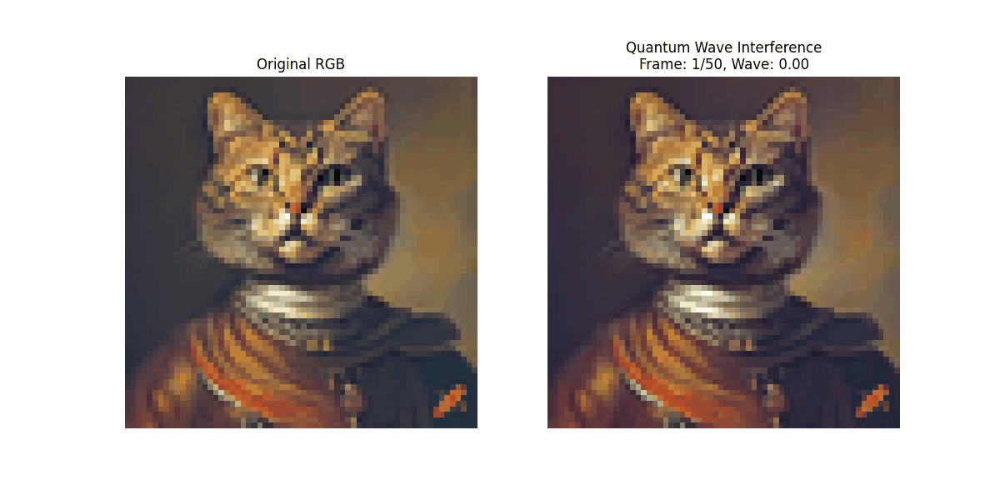

In [10]:
from matplotlib import animation
from IPython.display import Image
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit.circuit.library import QFT

# Initialize backend
backend = AerSimulator(method='statevector')

# === IMAGE SETUP FOR ANIMATION ===
# Change this path to your desired image
image_path = "figures/cat.webp"  # <-- CHANGE THIS PATH FOR YOUR IMAGE
MAX_IMAGE_DIM = 64

print(f"Loading image from: {image_path}")

# Load and process image
if not os.path.exists(image_path):
    print(f"Error: Image not found at {image_path}. Please check the path.")
    raise FileNotFoundError(f"Image not found at {image_path}")

img = PILImage.open(image_path).convert('RGB')

# Resize image if needed
original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension, no resize needed.")

# Prepare image channels
r, g, b = img.split()
shape = np.array(r).shape

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

def process_channel(flat_data, compression, wave_angle):
    qc = cFRQI(flat_data, compression)
    mem_qubits = list(range(qc.num_qubits - 1))
    qc.append(QFT(len(mem_qubits)).decompose(), mem_qubits)
    for j in range(len(mem_qubits)):
        qc.rz(wave_angle * np.sin(j * np.pi / len(mem_qubits)), j)
    qc.append(QFT(len(mem_qubits)).inverse().decompose(), mem_qubits)
    qc.save_statevector()
    qc = qc.decompose(reps=10)
    result = backend.run(qc).result()
    state = result.get_statevector()
    decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
    return reconstruct_img(decoded_flat, shape)

# Process all channels
r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

print("Image processing complete. Ready for animation!")

def create_quantum_animation(compression=0.0, max_wave=1.0, brightness=1.0, num_frames=50, fps=10):
    """
    Create animated quantum wave interference effect
    """
    try:
        def animate(i):
            t = i / (num_frames - 1) * 2 * np.pi  # Full cycle over all frames
            wave_angle = max_wave * np.sin(t)
            r_out = process_channel(r_data, compression, wave_angle)
            g_out = process_channel(g_data, compression, wave_angle * 1.2)
            b_out = process_channel(b_data, compression, wave_angle * 0.8)

            rgb_output = np.stack([r_out, g_out, b_out], axis=-1).astype(np.uint8)
            rgb_output = np.clip(rgb_output * brightness, 0, 255).astype(np.uint8)
            ax2.clear()
            ax2.imshow(rgb_output)
            ax2.set_title(f"Quantum Wave Interference\nFrame: {i+1}/{num_frames}, Wave: {wave_angle:.2f}")
            ax2.axis("off")
            return [ax2]

        rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
        ax1.imshow(rgb_original)
        ax1.set_title("Original RGB")
        ax1.axis("off")
        ax2.axis("off")

        print(f"Creating animation with {num_frames} frames...")
        ani = animation.FuncAnimation(fig, animate, frames=num_frames, interval=100, blit=False)
        writergif = animation.PillowWriter(fps=fps)

        # Save animation
        output_gif_path = "quantum_wave_interference.gif"
        output_dir = os.path.dirname(output_gif_path)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)
        ani.save(output_gif_path, writer=writergif)
        plt.close(fig)

        print(f"Animation saved as {output_gif_path}")
        return Image(filename=output_gif_path)

    except Exception as e:
        print(f"Error creating animation: {e}")
        return None

# Get user input for animation parameters
print("Animation Generator")
print("Use the parameters you found from the interactive sliders above.")
print("Speed Control:")
print("- Lower FPS = Slower animation (try 5-8 for slow, 15-20 for fast)")
print("- More frames = Smoother but longer animation")

try:
    compression = float(input("Enter compression value (0-100): ") or "0")
    max_wave = float(input("Enter max wave amplitude (0-6.28)(recommended 1): ") or "1.0")
    brightness = float(input("Enter brightness (0.1-2.0)(recommended 1): ") or "1.0")
    num_frames = int(input("Enter number of frames for animation (default 50): ") or "50")
    fps = int(input("Enter animation speed in FPS (default 10, try 5 for slower): ") or "10")

    print(f"\nGenerating animation with:")
    print(f"Compression: {compression}%")
    print(f"Max Wave: {max_wave}")
    print(f"Brightness: {brightness}")
    print(f"Frames: {num_frames}")
    print(f"Speed: {fps} FPS")

    # Create the animation
    result = create_quantum_animation(compression, max_wave, brightness, num_frames, fps)
    if result:
        display(result)

except ValueError as e:
    print(f"Invalid input: {e}")
    print("Please enter valid numeric values.")
except KeyboardInterrupt:
    print("Animation generation cancelled.")
except Exception as e:
    print(f"Error: {e}")

# Quantum Color Blend Effect


Preparation: You can specify your own image path in the IMAGE_PATH variable. The image is resized (preferably to a maximum dimension of 64x64 pixels, as larger sizes significantly increase quantum simulation time). Its color channels are then prepared for quantum processing.

Quantum Encoding: Pixel data is encoded into a quantum state using QPIXL's cFRQI.

Quantum Blending (via cry Gates):
The central operation for this effect is the application of cry (controlled-RY) gates.
These cry gates are applied between adjacent "memory qubits" (representing pixel information) within each channel's quantum circuit.

The blend_angle parameter dictates the strength of these controlled rotations, inducing a mixing or "blend" of amplitudes between neighboring pixel data. This quantum mixing results in the distinct color transformations observed in the output.

Decoding & Reconstruction: After the quantum operations, the statevector of the circuit is obtained via simulation (using AerSimulator), then decoded back into classical pixel intensities, and finally reconstructed into the visual image

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import FloatSlider, interact
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
import os

backend = AerSimulator(method='statevector')

image_path = "figures/mario_eg.png"  # You can change this path
MAX_IMAGE_DIM = 64

# --- Image loading and optional resizing ---
if not os.path.exists(image_path):
    print(f"Error: Image not found at {image_path}. Please check the path.")
    raise FileNotFoundError(f"Image not found at {image_path}")

img = PILImage.open(image_path).convert('RGB')

# Resize image if it's larger than MAX_IMAGE_DIM
original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension, no resize needed.")

r, g, b = img.split()
shape = np.array(r).shape

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

def process_channel(flat_data, compression, blend_angle):
    qc = cFRQI(flat_data, compression)
    mem_qubits = list(range(qc.num_qubits - 1))
    for j in range(len(mem_qubits) - 1):
        qc.cry(blend_angle, j, j + 1)
    qc.save_statevector()
    qc = qc.decompose(reps=10)
    result = backend.run(qc).result()
    state = result.get_statevector()
    decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
    return reconstruct_img(decoded_flat, shape)

def quantum_color_blend_preview(compression=0.0, blend_angle=0.0, brightness=1.0):
    try:
        r_out = process_channel(r_data, compression, blend_angle)
        g_out = process_channel(g_data, compression, blend_angle * 1.2)
        b_out = process_channel(b_data, compression, blend_angle * 0.8)

        rgb_output = np.stack([r_out, g_out, b_out], axis=-1).astype(np.uint8)
        rgb_output = np.clip(rgb_output * brightness, 0, 255).astype(np.uint8)
        rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)

        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title("Original RGB")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        plt.imshow(rgb_output)
        plt.title(f"Quantum Color Blend Preview\nCompression: {compression:.0f}%, Blend: {blend_angle:.2f}, Brightness: {brightness:.1f}")
        plt.axis("off")
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Error: {e}")
        # Fallback in case of error
        rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
        quantum_art = np.random.random((shape[0], shape[1], 3)) * 255
        quantum_art = np.clip(quantum_art * brightness, 0, 255).astype(np.uint8)
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title("Original RGB")
        plt.axis("off")
        plt.subplot(1, 2, 2)
        plt.imshow(quantum_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")
        plt.tight_layout()
        plt.show()

# Interactive sliders for preview
interact(
    quantum_color_blend_preview,
    compression=FloatSlider(min=0.0, max=100.0, step=5.0, value=0.0, description="Compression"),
    blend_angle=FloatSlider(min=0.0, max=2*np.pi, step=0.1, value=0.0, description="Blend Angle"),
    brightness=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.0, description="Brightness")
)

Image (17x28) is within max dimension, no resize needed.


interactive(children=(FloatSlider(value=0.0, description='Compression', step=5.0), FloatSlider(value=0.0, desc…

<function __main__.quantum_color_blend_preview(compression=0.0, blend_angle=0.0, brightness=1.0)>

# Cell 2 (Animation Generator):
This cell is designed for creating animated GIF outputs. Instead of interactive sliders, it prompts the user for specific animation parameters (like compression, max_blend for the peak blending intensity, brightness, num_frames for smoothness, and fps for playback speed). The blend_angle is then smoothly varied over the animation frames using a trigonometric function, generating a sequence of images that are compiled into an animated GIF, showcasing the dynamic application of the "Quantum Color Blend."

Loading image from: figures/mario_eg.png
Image (17x28) is within max dimension, no resize needed.
Image processing complete. Ready for animation!
Quantum Color Blend Animation Generator
Use the parameters you found from the interactive sliders above.

Speed Control:
- Lower FPS = Slower animation (try 10-15 for slow, 20-25 for fast)
- More frames = Smoother but longer animation

Recommended Settings (from original):
- Frames: 100 (smooth)
- FPS: 20 (good speed)
- Interval: 50ms (responsive)
Enter compression value (0-100): 0
Enter max blend amplitude (0-6.28): 1
Enter brightness (0.1-2.0): 1
Enter number of frames for animation (default 100): 50
Enter animation speed in FPS (default 20): 20

Generating animation with:
Compression: 0.0%
Max Blend: 1.0
Brightness: 1.0
Frames: 50
Speed: 20 FPS
Creating animation with 50 frames...
Animation saved as quantum_color_blend.gif


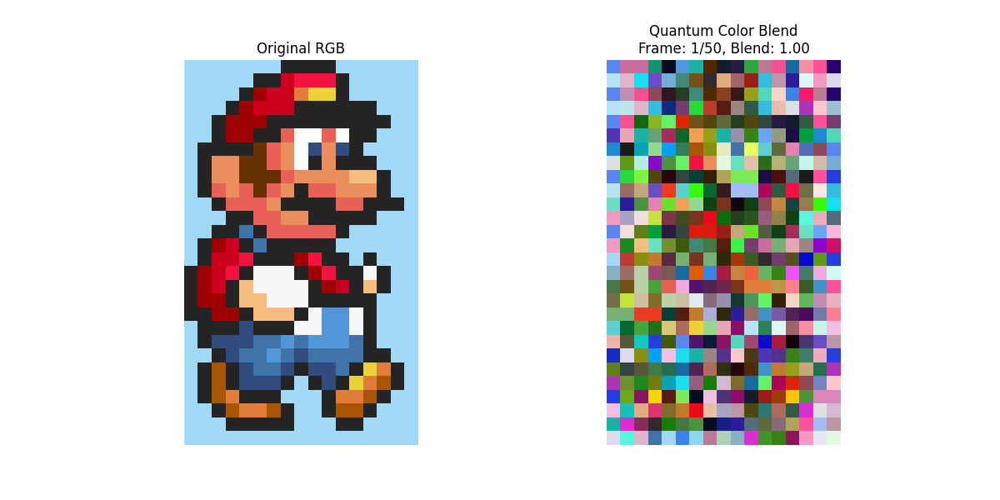

In [12]:
from matplotlib import animation
from IPython.display import Image
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit

# Initialize backend
backend = AerSimulator(method='statevector')

# === IMAGE SETUP FOR ANIMATION ===
# Change this path to your desired image
image_path = "figures/mario_eg.png"  # <-- CHANGE THIS PATH FOR YOUR IMAGE
MAX_IMAGE_DIM = 64

print(f"Loading image from: {image_path}")

# Load and process image
if not os.path.exists(image_path):
    print(f"Error: Image not found at {image_path}. Please check the path.")
    raise FileNotFoundError(f"Image not found at {image_path}")

img = PILImage.open(image_path).convert('RGB')

# Resize image if needed
original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension, no resize needed.")

# Prepare image channels
r, g, b = img.split()
shape = np.array(r).shape

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

def process_channel(flat_data, compression, blend_angle):
    qc = cFRQI(flat_data, compression)
    mem_qubits = list(range(qc.num_qubits - 1))
    for j in range(len(mem_qubits) - 1):
        qc.cry(blend_angle, j, j + 1)
    qc.save_statevector()
    qc = qc.decompose(reps=10)
    result = backend.run(qc).result()
    state = result.get_statevector()
    decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
    return reconstruct_img(decoded_flat, shape)

# Process all channels
r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

print("Image processing complete. Ready for animation!")

def create_quantum_color_blend_animation(compression=0.0, max_blend=1.0, brightness=1.0, num_frames=100, fps=20):
    """
    Create animated quantum color blend effect
    """
    try:
        def animate(i):
            t = i / (num_frames - 1) * 2 * np.pi  # Full cycle over all frames
            blend_angle = max_blend * np.cos(t)
            r_out = process_channel(r_data, compression, blend_angle)
            g_out = process_channel(g_data, compression, blend_angle * 1.2)
            b_out = process_channel(b_data, compression, blend_angle * 0.8)

            rgb_output = np.stack([r_out, g_out, b_out], axis=-1).astype(np.uint8)
            rgb_output = np.clip(rgb_output * brightness, 0, 255).astype(np.uint8)
            ax2.clear()
            ax2.imshow(rgb_output)
            ax2.set_title(f"Quantum Color Blend\nFrame: {i+1}/{num_frames}, Blend: {blend_angle:.2f}")
            ax2.axis("off")
            return [ax2]

        rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
        ax1.imshow(rgb_original)
        ax1.set_title("Original RGB")
        ax1.axis("off")
        ax2.axis("off")

        print(f"Creating animation with {num_frames} frames...")
        ani = animation.FuncAnimation(fig, animate, frames=num_frames, interval=50, blit=False)
        writergif = animation.PillowWriter(fps=fps)

        # Save animation
        output_gif_path = "quantum_color_blend.gif"
        output_dir = os.path.dirname(output_gif_path)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)
        ani.save(output_gif_path, writer=writergif)
        plt.close(fig)

        print(f"Animation saved as {output_gif_path}")
        return Image(filename=output_gif_path)

    except Exception as e:
        print(f"Error creating animation: {e}")
        return None

# Get user input for animation parameters
print("Quantum Color Blend Animation Generator")
print("Use the parameters you found from the interactive sliders above.")
print("\nSpeed Control:")
print("- Lower FPS = Slower animation (try 10-15 for slow, 20-25 for fast)")
print("- More frames = Smoother but longer animation")
print("\nRecommended Settings (from original):")
print("- Frames: 100 (smooth)")
print("- FPS: 20 (good speed)")
print("- Interval: 50ms (responsive)")

try:
    compression = float(input("Enter compression value (0-100)(recommended 0): ") or "0")
    max_blend = float(input("Enter max blend amplitude (0-6.28)(recommended 1): ") or "1.0")
    brightness = float(input("Enter brightness (0.1-2.0)(recommended 1): ") or "1.0")
    num_frames = int(input("Enter number of frames for animation (default 100): ") or "100")
    fps = int(input("Enter animation speed in FPS (default 20): ") or "20")

    print(f"\nGenerating animation with:")
    print(f"Compression: {compression}%")
    print(f"Max Blend: {max_blend}")
    print(f"Brightness: {brightness}")
    print(f"Frames: {num_frames}")
    print(f"Speed: {fps} FPS")

    # Create the animation
    result = create_quantum_color_blend_animation(compression, max_blend, brightness, num_frames, fps)
    if result:
        display(result)

except ValueError as e:
    print(f"Invalid input: {e}")
    print("Please enter valid numeric values.")
except KeyboardInterrupt:
    print("Animation generation cancelled.")
except Exception as e:
    print(f"Error: {e}")

# Quantum Grover Spotlight Effect

The "Quantum Grover Spotlight" effect simulates a moving or static "spotlight" on an image by enhancing specific regions of pixel data through a quantum process. This effect doesn't directly use Grover's algorithm for search, but rather uses a spotlight function to modify the pixel values which are then processed quantumly, reminiscent of how Grover's algorithm amplifies certain states

Quantum Encoding & Processing (process_channel function & cFRQI):
The spotlight-highlighted pixel data (which is still classical at this stage) is then preprocessed (preprocess_image, pad_0) and encoded into a quantum state using QPIXL's cFRQI circuit.

Crucially, for this specific effect, no further custom quantum gates (like QFT, rz, or cry as in other effects) are explicitly applied after the cFRQI encoding within the process_channel function itself.

The quantum part primarily involves the efficient encoding and subsequent decoding of the (pre-processed) pixel values, with the "effect" largely driven by the classical apply_spotlight function before quantum processing. The quantum circuit's role here is more about the novel way the image data is handled (encoded and decoded quantumly) after the classical spotlight application

You can dynamically control parameters such as compression, x_pos and y_pos (to move the spotlight), spotlight intensity, and overall brightness

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact, FloatSlider
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit

# Setup
backend = AerSimulator(method='statevector')
MAX_IMAGE_DIM = 64
image_path = "figures/mario_eg.png"  # You can change this to try different images

# Load and resize
img = PILImage.open(image_path).convert('RGB')
original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    scale = MAX_IMAGE_DIM / max(original_width, original_height)
    img = img.resize((int(original_width * scale), int(original_height * scale)), PILImage.Resampling.LANCZOS)

r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw), padded_size)
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

def apply_spotlight(data, x, y, intensity, sigma=2.0):
    Y, X = np.indices((H, W))
    gaussian = np.exp(-((X - x)**2 + (Y - y)**2) / (2 * sigma**2))
    highlighted = data + intensity * gaussian * 100
    return np.clip(highlighted, 0, 255)

def process_channel(channel_raw, compression, x, y, spotlight_intensity):
    highlighted = apply_spotlight(channel_raw, x, y, spotlight_intensity)
    padded = pad_0(preprocess_image(highlighted), padded_size)
    qc = cFRQI(padded, compression)
    qc.save_statevector()
    qc = qc.decompose(reps=10)
    result = backend.run(qc).result()
    state = result.get_statevector()
    decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
    return reconstruct_img(decoded_flat[:N], shape)

def preview_effect(compression, x_pos, y_pos, spotlight, brightness):
    r_out = process_channel(r_raw, compression, x_pos, y_pos, spotlight)
    g_out = process_channel(g_raw, compression, x_pos, y_pos, spotlight * 1.2)
    b_out = process_channel(b_raw, compression, x_pos, y_pos, spotlight * 0.8)

    combined = np.stack([r_out, g_out, b_out], axis=-1)
    combined = np.clip(combined * brightness, 0, 255).astype(np.uint8)

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8))
    plt.title("Original RGB")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(combined)
    plt.title("Quantum Grover Spotlight")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

interact(
    preview_effect,
    compression=FloatSlider(min=0, max=100, step=5, value=0, description="Compression"),
    x_pos=FloatSlider(min=0, max=W, step=1, value=W//2, description="X Position"),
    y_pos=FloatSlider(min=0, max=H, step=1, value=H//2, description="Y Position"),
    spotlight=FloatSlider(min=0.0, max=2.0, step=0.1, value=1.0, description="Spotlight"),
    brightness=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.0, description="Brightness")
)


interactive(children=(FloatSlider(value=0.0, description='Compression', step=5.0), FloatSlider(value=8.0, desc…

<function __main__.preview_effect(compression, x_pos, y_pos, spotlight, brightness)>

Enter spotlight pattern (concentric, random, elliptical): random
Enter brightness multiplier (e.g., 0.5 for darker, 1.0 for normal, 2.0 for brighter): 1.5
Loading image from: figures/mario_eg.png
Image (17x28) is within max dimension, no resize needed.

Starting animation creation with random pattern and brightness 1.5...
Generating animation frames...
Saving animation as grover_spotlight_animation.gif (this may take a while)...
Progress: 2.0% (Frame 1/50) - Elapsed: 0.0s - ETA: 0.0s
Progress: 2.0% (Frame 1/50) - Elapsed: 1.4s - ETA: 0.0s
Progress: 12.0% (Frame 6/50) - Elapsed: 9.4s - ETA: 68.6s
Progress: 22.0% (Frame 11/50) - Elapsed: 16.2s - ETA: 57.4s
Progress: 32.0% (Frame 16/50) - Elapsed: 24.1s - ETA: 51.2s
Progress: 42.0% (Frame 21/50) - Elapsed: 31.0s - ETA: 42.7s
Progress: 52.0% (Frame 26/50) - Elapsed: 39.6s - ETA: 36.5s
Progress: 62.0% (Frame 31/50) - Elapsed: 47.2s - ETA: 28.9s
Progress: 72.0% (Frame 36/50) - Elapsed: 54.4s - ETA: 21.1s
Progress: 82.0% (Frame 41/50) - Elaps

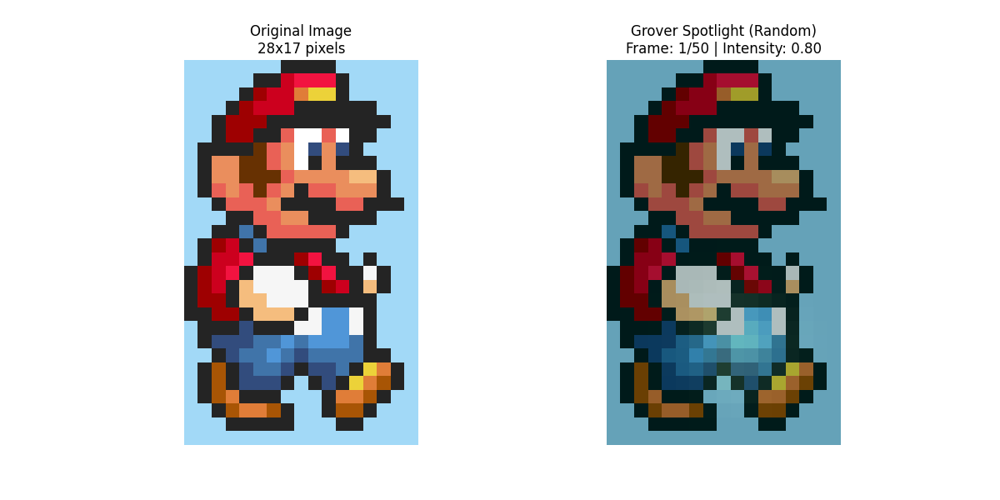

In [9]:
# Cell 2: Animation Generator

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from matplotlib import animation
from IPython.display import Image, display
import time
import os

# --- Configuration ---
MAX_IMAGE_DIM = 64  # Default maximum dimension for image resizing
backend = AerSimulator(method='statevector')

# --- USER SETTINGS for Animation ---
IMAGE_PATH = "figures/mario_eg.png"  # Path to your input image
OUTPUT_FILENAME = "grover_spotlight_animation.gif" # Output GIF file name

# Animation Parameters (Default values, can be overridden by user input)
COMPRESSION = 0.0
MAX_SPOTLIGHT_INTENSITY = 1.0 # This is the max amplitude of the spotlight
R_FACTOR = 1.0
G_FACTOR = 1.2
B_FACTOR = 0.8

# Animation Playback Settings (Default values, can be overridden by user input)
NUM_FRAMES = 50   # Number of frames for the animation
FPS = 20          # Frames per second for the animation

# --- Interactive Spotlight Pattern Selection ---
valid_patterns = ["concentric", "random", "elliptical"]
SPOTLIGHT_PATTERN = None
while SPOTLIGHT_PATTERN not in valid_patterns:
    user_input = input(f"Enter spotlight pattern ({', '.join(valid_patterns)}): ").lower().strip()
    if user_input in valid_patterns:
        SPOTLIGHT_PATTERN = user_input
    else:
        print(f"Invalid pattern '{user_input}'. Please choose from: {', '.join(valid_patterns)}")

# --- Interactive Brightness Selection ---
BRIGHTNESS = None
while BRIGHTNESS is None:
    try:
        user_input = input("Enter brightness multiplier (e.g., 0.5 for darker, 1.0 for normal, 2.0 for brighter): ")
        brightness_val = float(user_input)
        if 0.1 <= brightness_val <= 3.0: # Add a reasonable range check
            BRIGHTNESS = brightness_val
        else:
            print("Brightness must be between 0.1 and 3.0.")
    except ValueError:
        print("Invalid input. Please enter a number for brightness.")


# --- Image Loading and Preparation ---
print(f"Loading image from: {IMAGE_PATH}")

if not os.path.exists(IMAGE_PATH):
    print(f"Error: Image not found at {IMAGE_PATH}. Using fallback random image.")
    fallback_img = np.random.randint(0, 255, (MAX_IMAGE_DIM, MAX_IMAGE_DIM, 3), dtype=np.uint8)
    img = PILImage.fromarray(fallback_img)
    original_width, original_height = MAX_IMAGE_DIM, MAX_IMAGE_DIM
else:
    img = PILImage.open(IMAGE_PATH).convert('RGB')
    original_width, original_height = img.size

if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension, no resize needed.")

r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

# --- Helper Functions ---
def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

def apply_spotlight(data, x, y, spotlight_intensity, sigma=2.0):
    highlighted = data.copy().astype(np.float32)
    Y, X = np.indices((H, W))
    gaussian = np.exp(-((X - x)**2 + (Y - y)**2) / (2 * sigma**2))
    highlighted += spotlight_intensity * gaussian * 100
    return np.clip(highlighted, 0, 255)

def process_channel_animation(channel_raw_data, compression, x, y, spotlight_intensity):
    try:
        highlighted = apply_spotlight(channel_raw_data, x, y, spotlight_intensity)
        padded = pad_0(preprocess_image(highlighted), padded_size)
        qc = cFRQI(padded, compression)
        qc.save_statevector()
        qc = qc.decompose(reps=10)
        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        print(f"Quantum processing error (fallback): {e}")
        return np.random.random(shape) * 255

# --- Animation Creation Function ---
def create_grover_spotlight_animation():
    print(f"\nStarting animation creation with {SPOTLIGHT_PATTERN} pattern and brightness {BRIGHTNESS}...")
    start_time = time.time()

    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    im = ax2.imshow(np.zeros_like(rgb_original))
    ax2.set_title("Grover Spotlight Effect")
    ax2.axis("off")

    def animate(frame):
        # Update progress
        if frame % max(1, NUM_FRAMES // 10) == 0 or frame == NUM_FRAMES - 1:
            elapsed = time.time() - start_time
            progress = (frame + 1) / NUM_FRAMES * 100
            eta = elapsed / (frame + 1) * (NUM_FRAMES - frame - 1) if frame > 0 else 0
            print(f"Progress: {progress:.1f}% (Frame {frame+1}/{NUM_FRAMES}) - Elapsed: {elapsed:.1f}s - ETA: {eta:.1f}s")

        # Spotlight Pattern Logic
        t = frame / (NUM_FRAMES - 1) * 2 * np.pi # Progress from 0 to 2*pi

        x_center, y_center = W / 2, H / 2 # Default center
        spotlight_intensity_scalar = MAX_SPOTLIGHT_INTENSITY * (0.5 + 0.5 * np.sin(t)) # Base intensity

        if SPOTLIGHT_PATTERN == "concentric":
            radius = (min(W, H) / 4) * (0.5 + 0.5 * np.sin(t))
            x_center = W / 2 + radius * np.cos(t)
            y_center = H / 2 + radius * np.sin(t)
            spotlight_intensity_scalar = MAX_SPOTLIGHT_INTENSITY * (0.5 + 0.5 * np.sin(t))
        elif SPOTLIGHT_PATTERN == "random":
            np.random.seed(frame) # Seed for reproducibility per frame
            x_center = np.random.uniform(0, W)
            y_center = np.random.uniform(0, H)
            spotlight_intensity_scalar = MAX_SPOTLIGHT_INTENSITY * np.random.uniform(0.5, 1.0)
        elif SPOTLIGHT_PATTERN == "elliptical":
            a = W / 3 # Semi-major axis
            b = H / 4 # Semi-minor axis
            x_center = W / 2 + a * np.cos(t)
            y_center = H / 2 + b * np.sin(t)
            spotlight_intensity_scalar = MAX_SPOTLIGHT_INTENSITY * (0.7 + 0.3 * np.sin(t))

        r_out = process_channel_animation(r_raw, COMPRESSION, x_center, y_center, spotlight_intensity_scalar * R_FACTOR)
        g_out = process_channel_animation(g_raw, COMPRESSION, x_center, y_center, spotlight_intensity_scalar * G_FACTOR)
        b_out = process_channel_animation(b_raw, COMPRESSION, x_center, y_center, spotlight_intensity_scalar * B_FACTOR)

        rgb_output = np.stack([r_out, g_out, b_out], axis=-1)
        rgb_output = np.clip(rgb_output * BRIGHTNESS, 0, 255).astype(np.uint8) # Apply BRIGHTNESS here

        im.set_data(rgb_output)
        ax2.set_title(f"Grover Spotlight ({SPOTLIGHT_PATTERN.capitalize()})\nFrame: {frame+1}/{NUM_FRAMES} | Intensity: {spotlight_intensity_scalar:.2f}")
        return [im]

    print("Generating animation frames...")
    try:
        interval_ms = int(1000 / FPS)
        ani = animation.FuncAnimation(fig, animate, frames=NUM_FRAMES, interval=interval_ms, blit=False)

        output_dir = os.path.dirname(OUTPUT_FILENAME)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)

        print(f"Saving animation as {OUTPUT_FILENAME} (this may take a while)...")
        writergif = animation.PillowWriter(fps=FPS)
        ani.save(OUTPUT_FILENAME, writer=writergif)

        plt.close(fig)

        if os.path.exists(OUTPUT_FILENAME):
            file_size = os.path.getsize(OUTPUT_FILENAME) / 1024 / 1024
            total_time = time.time() - start_time
            print(f"\nAnimation saved successfully!")
            print(f"File: {OUTPUT_FILENAME}")
            print(f"Size: {file_size:.2f} MB")
            print(f"Total processing time: {total_time:.1f} seconds")
            print(f"Average time per frame: {total_time/NUM_FRAMES:.2f} seconds")

            print(f"\nDisplaying animation in output cell...")
            gif_display = Image(filename=OUTPUT_FILENAME)
            display(gif_display)
            return gif_display
        else:
            print("Error: Animation file was not created properly.")
            return None

    except Exception as e:
        print(f"Error creating animation: {e}")
        # Fallback visualization
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title(f"Original Image\n{H}x{W} pixels")
        plt.axis("off")
        plt.subplot(1, 2, 2)
        # Apply brightness to fallback as well
        fallback_art = np.random.random((H, W, 3)) * 255 * BRIGHTNESS
        fallback_art = np.clip(fallback_art, 0, 255).astype(np.uint8)
        plt.imshow(fallback_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")
        plt.tight_layout()
        plt.show()
        total_time = time.time() - start_time
        print(f"Fallback visualization complete. Time: {total_time:.1f} seconds")
        return None

# --- Execute Animation Creation ---
if __name__ == '__main__':
    create_grover_spotlight_animation()

# Quantum Tunneling Effect:
The "Quantum Tunneling" effect creates a visual distortion that can resemble a "tunneling" or "bleeding" of pixel information across an image. This is achieved by applying controlled-RY (cry) gates between adjacent pixel data encoded in the quantum circuit, with the rotation angle specifically modulated sinusoidally across the qubits

Quantum Tunneling (via cry gates with Sinusoidal Angle):

The core of this effect involves the application of cry (controlled-RY) gates. These gates are applied between adjacent "memory qubits" (representing pixel positions/amplitudes).

Brief Difference from Quantum Color Blend: While the "Quantum Color Blend" effect also uses cry gates for mixing, it typically applies them with a global or simply varied blend_angle. For "Quantum Tunneling," the rotation angle for each cry gate is specifically and sinusoidally modulated (e.g., tunnel_angle * np.sin(j * np.pi / len(mem_qubits))) based on the qubit's index. This varying strength of interaction across the qubits creates the distinctive wave-like or "tunneling" interference pattern, allowing pixel information to "bleed" or "tunnel" into neighboring areas in a structured way.

You can dynamically adjust parameters such as compression, tunnel_angle (to control the strength and visual appearance of the tunneling), brightness, and individual r_factor, g_factor, b_factor (to fine-tune color channel contributions). As you modify these sliders, the quantum tunneling process executes, and the static result is immediately displayed, allowing for real-time visual experimentation.

In [27]:
# Cell 1: Interactive Parameter Testing


import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import FloatSlider, interact
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
import os

# Configuration
MAX_IMAGE_DIM = 64  # Maximum dimension for image resizing
backend = AerSimulator(method='statevector')

# Load and prepare image with flexible resizing
image_path = "figures/mario_eg.png"  # Update this path as needed

print(f"Loading image from: {image_path}")

# Check if image exists
if not os.path.exists(image_path):
    print(f"Error: Image not found at {image_path}. Please check the path.")
    raise FileNotFoundError(f"Image not found at {image_path}")

img = PILImage.open(image_path).convert('RGB')

# Intelligent resizing that maintains aspect ratio
original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension ({MAX_IMAGE_DIM}), no resize needed.")

# Prepare image channels
r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))

print(f"Final image dimensions: {H}x{W} pixels")
print(f"Padded size for quantum processing: {padded_size}")

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

print("Image channels prepared successfully.")

def process_channel(flat_data, compression, tunnel_angle):
    try:
        qc = cFRQI(flat_data, compression)
        mem_qubits = list(range(qc.num_qubits - 1))
        for j in range(len(mem_qubits) - 1):
            qc.cry(tunnel_angle * np.sin(j * np.pi / len(mem_qubits)), j, j + 1)
        qc.save_statevector()
        qc = qc.decompose(reps=10)
        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        print(f"Quantum processing error: {e}")
        return np.random.random(shape) * 255

def preview_quantum_tunneling_effect(compression=0.0, tunnel_angle=1.0, brightness=1.0, r_factor=1.0, g_factor=1.2, b_factor=0.8): # <-- Renamed function
    """
    Real-time preview of quantum tunneling effect with improved controls

    Parameters:
    - compression: Quantum compression level (0-100%)
    - tunnel_angle: Current tunneling effect strength (0-6.28)
    - brightness: Image brightness multiplier (0.1-3.0)
    - r_factor: Red channel tunneling multiplier (0.1-2.0)
    - g_factor: Green channel tunneling multiplier (0.1-2.0)
    - b_factor: Blue channel tunneling multiplier (0.1-2.0)
    """

    # Process each channel with individual factors
    r_out = process_channel(r_data, compression, tunnel_angle * r_factor)
    g_out = process_channel(g_data, compression, tunnel_angle * g_factor)
    b_out = process_channel(b_data, compression, tunnel_angle * b_factor)

    # Combine channels and apply brightness
    rgb_output = np.stack([r_out, g_out, b_out], axis=-1).astype(np.uint8)
    rgb_output = np.clip(rgb_output * brightness, 0, 255).astype(np.uint8)
    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)

    # Display comparison
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    ax2.imshow(rgb_output)
    ax2.set_title(f"Quantum Tunneling Effect Preview\nC:{compression:.0f}% T:{tunnel_angle:.1f} B:{brightness:.1f}") # <-- Changed title
    ax2.axis("off")

    plt.tight_layout()
    plt.show()


interact(
    preview_quantum_tunneling_effect, # <-- Updated function name in interact
    compression=FloatSlider(min=0.0, max=100.0, step=5.0, value=0.0, description="Compression"),
    tunnel_angle=FloatSlider(min=0.0, max=2*np.pi, step=0.1, value=1.0, description="Tunnel Angle"),
    brightness=FloatSlider(min=0.1, max=3.0, step=0.1, value=1.0, description="Brightness"),
    r_factor=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.0, description="Red Factor"),
    g_factor=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.2, description="Green Factor"),
    b_factor=FloatSlider(min=0.1, max=2.0, step=0.1, value=0.8, description="Blue Factor")
)

Loading image from: figures/mario_eg.png
Image (17x28) is within max dimension (64), no resize needed.
Final image dimensions: 28x17 pixels
Padded size for quantum processing: 512
Image channels prepared successfully.


interactive(children=(FloatSlider(value=0.0, description='Compression', step=5.0), FloatSlider(value=1.0, desc…

<function __main__.preview_quantum_tunneling_effect(compression=0.0, tunnel_angle=1.0, brightness=1.0, r_factor=1.0, g_factor=1.2, b_factor=0.8)>

Quantum Tunneling Animation Generator
Image: figures/mario_eg.png
Output: quantum_tunneling_animation.gif
Animation: 50 frames at 20 FPS
Duration: 2.5 seconds
Loading image from: figures/mario_eg.png
Image (17x28) is within max dimension (64), no resize needed.
Final processing dimensions: 28x17 pixels
Starting animation creation...
Generating animation frames...
Saving animation as quantum_tunneling_animation.gif...
Progress: 2.0% (Frame 1/50) - Elapsed: 0.1s - ETA: 0.0s
Progress: 2.0% (Frame 1/50) - Elapsed: 3.2s - ETA: 0.0s
Progress: 12.0% (Frame 6/50) - Elapsed: 10.7s - ETA: 78.7s
Progress: 22.0% (Frame 11/50) - Elapsed: 19.1s - ETA: 67.8s
Progress: 32.0% (Frame 16/50) - Elapsed: 27.4s - ETA: 58.2s
Progress: 42.0% (Frame 21/50) - Elapsed: 35.0s - ETA: 48.3s
Progress: 52.0% (Frame 26/50) - Elapsed: 43.4s - ETA: 40.1s
Progress: 62.0% (Frame 31/50) - Elapsed: 51.0s - ETA: 31.3s
Progress: 72.0% (Frame 36/50) - Elapsed: 59.2s - ETA: 23.0s
Progress: 82.0% (Frame 41/50) - Elapsed: 67.8s -

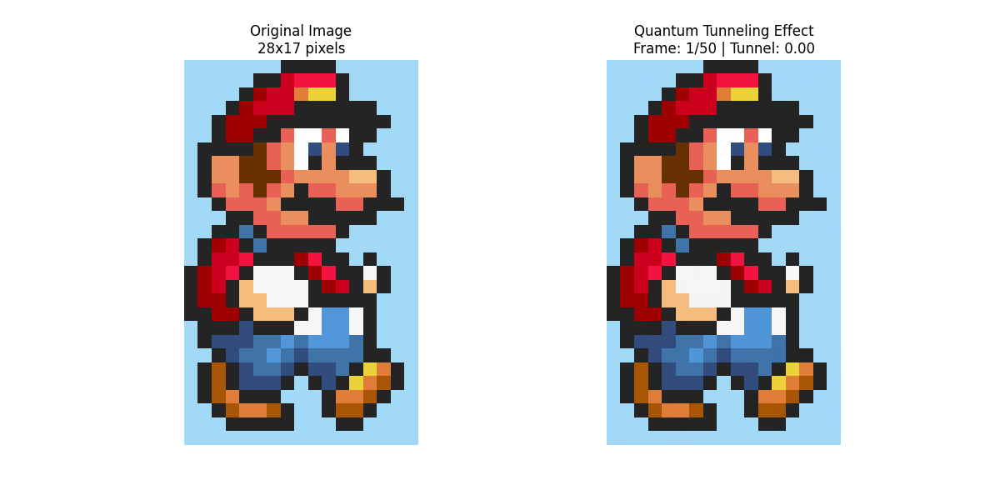

Animation generation completed successfully!
The GIF is displayed above and saved to file.


In [26]:
# Cell 2: Animation Generator
# Independent animation creation with comprehensive controls

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from matplotlib import animation
from IPython.display import Image, display
import time
import os

# Configuration
MAX_IMAGE_DIM = 64
backend = AerSimulator(method='statevector')

# USER SETTINGS
IMAGE_PATH = "figures/mario_eg.png"  #
OUTPUT_FILENAME = "quantum_tunneling_animation.gif"

# Animation Parameters
COMPRESSION = 0.0
MAX_TUNNEL_ANGLE = 1.0
BRIGHTNESS = 1.0
R_FACTOR = 1.0
G_FACTOR = 1.2
B_FACTOR = 0.8

# Animation Settings
NUM_FRAMES = 50
FPS = 20

print("Quantum Tunneling Animation Generator")
print(f"Image: {IMAGE_PATH}")
print(f"Output: {OUTPUT_FILENAME}")
print(f"Animation: {NUM_FRAMES} frames at {FPS} FPS")
print(f"Duration: {NUM_FRAMES/FPS:.1f} seconds")

# Load and prepare image
print(f"Loading image from: {IMAGE_PATH}")

if not os.path.exists(IMAGE_PATH):
    print(f"Error: Image not found at {IMAGE_PATH}. Please check the path.")
    print("Using fallback random image for demonstration...")
    # Create a fallback image
    fallback_img = np.random.randint(0, 255, (MAX_IMAGE_DIM, MAX_IMAGE_DIM, 3), dtype=np.uint8)
    img = PILImage.fromarray(fallback_img)
    original_width, original_height = MAX_IMAGE_DIM, MAX_IMAGE_DIM
else:
    img = PILImage.open(IMAGE_PATH).convert('RGB')
    original_width, original_height = img.size

# Resize image if needed
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension ({MAX_IMAGE_DIM}), no resize needed.")

# Prepare image channels
r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))

print(f"Final processing dimensions: {H}x{W} pixels")

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

def process_channel_safe(flat_data, compression, tunnel_angle):
    """Process channel with error handling"""
    try:
        qc = cFRQI(flat_data, compression)
        mem_qubits = list(range(qc.num_qubits - 1))
        for j in range(len(mem_qubits) - 1):
            qc.cry(tunnel_angle * np.sin(j * np.pi / len(mem_qubits)), j, j + 1)
        qc.save_statevector()
        qc = qc.decompose(reps=10)
        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        print(f"Quantum processing error at frame, using fallback: {e}")
        # Return original channel data as fallback
        return np.array(r_raw if 'r_raw' in locals() else np.random.random(shape) * 255)

def create_quantum_animation():

    print(f"Starting animation creation...")
    start_time = time.time()

    # Setup figure
    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    ax2.axis("off")

    def animate(frame):
        # Progress feedback
        if frame % max(1, NUM_FRAMES // 10) == 0 or frame == NUM_FRAMES - 1:
            elapsed = time.time() - start_time
            progress = (frame + 1) / NUM_FRAMES * 100
            eta = elapsed / (frame + 1) * (NUM_FRAMES - frame - 1) if frame > 0 else 0
            print(f"Progress: {progress:.1f}% (Frame {frame+1}/{NUM_FRAMES}) - Elapsed: {elapsed:.1f}s - ETA: {eta:.1f}s")

        # Calculate smooth tunneling effect
        t = frame / (NUM_FRAMES - 1) * 2 * np.pi
        current_tunnel = MAX_TUNNEL_ANGLE * np.sin(t)

        # Process each channel
        r_out = process_channel_safe(r_data, COMPRESSION, current_tunnel * R_FACTOR)
        g_out = process_channel_safe(g_data, COMPRESSION, current_tunnel * G_FACTOR)
        b_out = process_channel_safe(b_data, COMPRESSION, current_tunnel * B_FACTOR)

        # Combine channels
        rgb_output = np.stack([r_out, g_out, b_out], axis=-1)
        rgb_output = np.clip(rgb_output * BRIGHTNESS, 0, 255).astype(np.uint8)

        # Clear and update display
        ax2.clear()
        ax2.imshow(rgb_output)
        ax2.set_title(f"Quantum Tunneling Effect\nFrame: {frame+1}/{NUM_FRAMES} | Tunnel: {current_tunnel:.2f}")
        ax2.axis("off")

        return [ax2]

    # Create animation
    print("Generating animation frames...")
    try:
        interval = int(1000 / FPS)
        # *** IMPORTANT CHANGE HERE: blit=False ***
        ani = animation.FuncAnimation(fig, animate, frames=NUM_FRAMES, interval=interval, blit=False)

        # Prepare output directory
        output_dir = os.path.dirname(OUTPUT_FILENAME)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)

        # Save animation
        print(f"Saving animation as {OUTPUT_FILENAME}...")
        writergif = animation.PillowWriter(fps=FPS)
        ani.save(OUTPUT_FILENAME, writer=writergif)

        plt.close(fig)  # Close figure after saving

        # Success feedback with file information
        if os.path.exists(OUTPUT_FILENAME):
            file_size = os.path.getsize(OUTPUT_FILENAME) / 1024 / 1024  # MB
            total_time = time.time() - start_time
            print(f"Animation saved successfully!")
            print(f"File: {OUTPUT_FILENAME}")
            print(f"Size: {file_size:.2f} MB")
            print(f"Total processing time: {total_time:.1f} seconds")
            print(f"Average time per frame: {total_time/NUM_FRAMES:.2f} seconds")

            # Display the GIF in the output cell
            print(f"\nDisplaying animation in output cell...")
            gif_display = Image(filename=OUTPUT_FILENAME)
            display(gif_display)  # This will show the GIF in the cell output
            return gif_display
        else:
            print("Error: Animation file was not created properly.")
            return None

    except Exception as e:
        print(f"Error creating animation: {e}")
        print("Creating fallback visualization...")

        # Fallback visualization
        plt.figure(figsize=(12, 6))

        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title(f"Original Image\n{H}x{W} pixels")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        # Create a quantum-inspired fallback effect
        fallback_art = np.random.random((H, W, 3)) * 255 * BRIGHTNESS
        fallback_art = np.clip(fallback_art, 0, 255).astype(np.uint8)
        plt.imshow(fallback_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

        total_time = time.time() - start_time
        print(f"Fallback visualization complete. Time: {total_time:.1f} seconds")
        return None

# Execute animation creation
try:
    result = create_quantum_animation()

    if result:
        print("Animation generation completed successfully!")
        print("The GIF is displayed above and saved to file.")
    else:
        print("Animation generation encountered issues, but fallback visualization was created.")

except Exception as e:
    print(f"Critical error in animation creation: {e}")
    print("Please check your QPIXL installation and image path.")

# As i had increased the dimension it was fun to observe Mario move a little forward and backward , but yea you can adjust the FPS for a more smoother animation

Quantum Tunneling Animation Generator
Image: figures/mario_eg.png
Output: quantum_tunneling_animation.gif
Animation: 50 frames at 75 FPS
Duration: 0.7 seconds
Loading image from: figures/mario_eg.png
Image resized to fixed dimensions: (64x64)
Final processing dimensions: 64x64 pixels
Starting animation creation...
Generating animation frames...
Saving animation as quantum_tunneling_animation.gif...
Progress: 2.0% (Frame 1/50) - Elapsed: 0.0s - ETA: 0.0s
Progress: 2.0% (Frame 1/50) - Elapsed: 4.2s - ETA: 0.0s
Progress: 12.0% (Frame 6/50) - Elapsed: 15.2s - ETA: 111.8s
Progress: 22.0% (Frame 11/50) - Elapsed: 26.3s - ETA: 93.2s
Progress: 32.0% (Frame 16/50) - Elapsed: 39.5s - ETA: 84.0s
Progress: 42.0% (Frame 21/50) - Elapsed: 51.5s - ETA: 71.1s
Progress: 52.0% (Frame 26/50) - Elapsed: 62.7s - ETA: 57.9s
Progress: 62.0% (Frame 31/50) - Elapsed: 72.9s - ETA: 44.7s
Progress: 72.0% (Frame 36/50) - Elapsed: 83.8s - ETA: 32.6s
Progress: 82.0% (Frame 41/50) - Elapsed: 94.9s - ETA: 20.8s
Progre

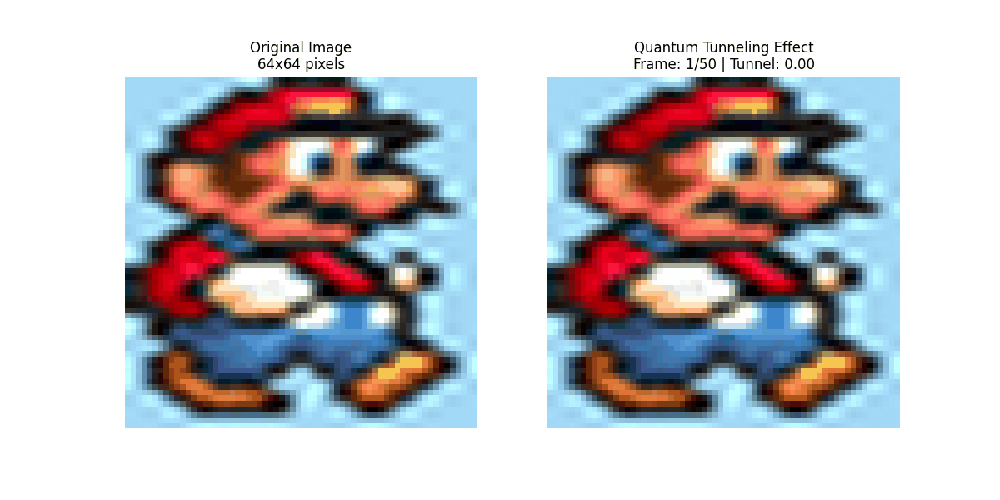

Animation generation completed successfully!
The GIF is displayed above and saved to file.


In [7]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from matplotlib import animation
from IPython.display import Image, display
import time
import os

MAX_IMAGE_DIM = 64
backend = AerSimulator(method='statevector')

IMAGE_PATH = "figures/mario_eg.png"
OUTPUT_FILENAME = "quantum_tunneling_animation.gif"

COMPRESSION = 0.0
MAX_TUNNEL_ANGLE = 1.0
BRIGHTNESS = 1.0
R_FACTOR = 1.0
G_FACTOR = 1.2
B_FACTOR = 0.8

NUM_FRAMES = 50
FPS = 75 # Increased frame rate to 75

print("Quantum Tunneling Animation Generator")
print(f"Image: {IMAGE_PATH}")
print(f"Output: {OUTPUT_FILENAME}")
print(f"Animation: {NUM_FRAMES} frames at {FPS} FPS")
print(f"Duration: {NUM_FRAMES/FPS:.1f} seconds")

print(f"Loading image from: {IMAGE_PATH}")

if not os.path.exists(IMAGE_PATH):
    print(f"Error: Image not found at {IMAGE_PATH}. Please check the path.")
    print("Using fallback random image for demonstration...")
    aspect_ratio = 64 / 64
    if aspect_ratio > 1:
        fallback_width = MAX_IMAGE_DIM
        fallback_height = int(MAX_IMAGE_DIM / aspect_ratio)
    else:
        fallback_height = MAX_IMAGE_DIM
        fallback_width = int(MAX_IMAGE_DIM * aspect_ratio)
    fallback_img_array = np.random.randint(0, 255, (fallback_height, fallback_width, 3), dtype=np.uint8)
    img = PILImage.fromarray(fallback_img_array)
    original_width, original_height = img.size
else:
    img = PILImage.open(IMAGE_PATH).convert('RGB')
    original_width, original_height = img.size

# Force resize to MAX_IMAGE_DIM x MAX_IMAGE_DIM (64x64)
# This will override aspect ratio preservation for a fixed output size.
img = img.resize((MAX_IMAGE_DIM, MAX_IMAGE_DIM), PILImage.Resampling.LANCZOS)
print(f"Image resized to fixed dimensions: ({MAX_IMAGE_DIM}x{MAX_IMAGE_DIM})")


r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))

print(f"Final processing dimensions: {H}x{W} pixels")

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

def process_channel_safe(flat_data, compression, tunnel_angle):
    try:
        qc = cFRQI(flat_data, compression)
        mem_qubits = list(range(qc.num_qubits - 1))
        if len(mem_qubits) < 2:
            raise ValueError("Not enough qubits for tunneling effect (requires at least 2 data qubits).")

        for j in range(len(mem_qubits) - 1):
            qc.cry(tunnel_angle * np.sin(j * np.pi / len(mem_qubits)), j, j + 1)

        qc.save_statevector()

        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        print(f"Quantum processing error at frame, using fallback: {e}")
        return np.array(r_raw if 'r_raw' in locals() else np.random.random(shape) * 255)

def create_quantum_animation():

    print(f"Starting animation creation...")
    start_time = time.time()

    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    ax2.axis("off")

    def animate(frame):
        if frame % max(1, NUM_FRAMES // 10) == 0 or frame == NUM_FRAMES - 1:
            elapsed = time.time() - start_time
            progress = (frame + 1) / NUM_FRAMES * 100
            eta = elapsed / (frame + 1) * (NUM_FRAMES - frame - 1) if frame > 0 else 0
            print(f"Progress: {progress:.1f}% (Frame {frame+1}/{NUM_FRAMES}) - Elapsed: {elapsed:.1f}s - ETA: {eta:.1f}s")

        t = frame / (NUM_FRAMES - 1) * 2 * np.pi
        current_tunnel = MAX_TUNNEL_ANGLE * np.sin(t)

        r_out = process_channel_safe(r_data, COMPRESSION, current_tunnel * R_FACTOR)
        g_out = process_channel_safe(g_data, COMPRESSION, current_tunnel * G_FACTOR)
        b_out = process_channel_safe(b_data, COMPRESSION, current_tunnel * B_FACTOR)

        rgb_output = np.stack([r_out, g_out, b_out], axis=-1)
        rgb_output = np.clip(rgb_output * BRIGHTNESS, 0, 255).astype(np.uint8)

        ax2.clear()
        ax2.imshow(rgb_output)
        ax2.set_title(f"Quantum Tunneling Effect\nFrame: {frame+1}/{NUM_FRAMES} | Tunnel: {current_tunnel:.2f}")
        ax2.axis("off")

        return [ax2]

    print("Generating animation frames...")
    try:
        interval = int(1000 / FPS)
        ani = animation.FuncAnimation(fig, animate, frames=NUM_FRAMES, interval=interval, blit=False)

        output_dir = os.path.dirname(OUTPUT_FILENAME)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)

        print(f"Saving animation as {OUTPUT_FILENAME}...")
        writergif = animation.PillowWriter(fps=FPS)
        ani.save(OUTPUT_FILENAME, writer=writergif)

        plt.close(fig)

        if os.path.exists(OUTPUT_FILENAME):
            file_size = os.path.getsize(OUTPUT_FILENAME) / 1024 / 1024
            total_time = time.time() - start_time
            print(f"Animation saved successfully!")
            print(f"File: {OUTPUT_FILENAME}")
            print(f"Size: {file_size:.2f} MB")
            print(f"Total processing time: {total_time:.1f} seconds")
            print(f"Average time per frame: {total_time/NUM_FRAMES:.2f} seconds")

            print(f"\nDisplaying animation in output cell...")
            gif_display = Image(filename=OUTPUT_FILENAME)
            display(gif_display)
            return gif_display
        else:
            print("Error: Animation file was not created properly.")
            return None

    except Exception as e:
        print(f"Error creating animation: {e}")
        print("Creating fallback visualization...")

        plt.figure(figsize=(12, 6))

        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title(f"Original Image\n{H}x{W} pixels")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        fallback_art = np.random.random((H, W, 3)) * 255 * BRIGHTNESS
        fallback_art = np.clip(fallback_art, 0, 255).astype(np.uint8)
        plt.imshow(fallback_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

        total_time = time.time() - start_time
        print(f"Fallback visualization complete. Time: {total_time:.1f} seconds")
        return None

try:
    result = create_quantum_animation()

    if result:
        print("Animation generation completed successfully!")
        print("The GIF is displayed above and saved to file.")
    else:
        print("Animation generation encountered issues, but fallback visualization was created.")

except Exception as e:
    print(f"Critical error in animation creation: {e}")
    print("Please check your QPIXL installation and image path.")

# Quantum Frequency Ripple Effect:

The "Quantum Frequency Ripple" effect introduces wave-like distortions or "ripples" across an image by manipulating its pixel data in a quantum frequency domain. This is achieved through the Quantum Fourier Transform (QFT) and targeted phase shifts applied via rz gates, creating frequency-based interference patterns

Quantum Encoding (cFRQI): QPIXL's cFRQI circuit encodes the prepared pixel data of each color channel into a quantum state.

Quantum Rippling (via QFT and rz gates):

The core of this effect utilizes the Quantum Fourier Transform (QFT). The QFT effectively transforms the encoded pixel information from its spatial (position) domain into a frequency-like domain within the quantum state.

While in this "frequency domain," rz (Z-rotation) gates are applied to individual memory qubits. The rotation angle for each rz gate is dynamically set to ripple_angle * np.sin(j * np.pi / len(mem_qubits)).

This sinusoidal modulation of phase shifts across the qubits introduces specific "ripples" or interference patterns in the frequency representation.

An inverse QFT is then applied to transform the quantum state back to the spatial domain, where these frequency-domain ripples become visible as wave-like distortions on the image.

You can dynamically adjust parameters such as compression, ripple_angle (controlling the strength and appearance of the ripples), brightness, and individual r_factor, g_factor, b_factor (to fine-tune color channel contributions). As you modify these sliders, the quantum frequency ripple process executes, and the static result is immediately displayed, allowing for real-time visual experimentation.

In [10]:
# Cell 1: Interactive Parameter Testing (Real-time Preview)

import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import FloatSlider, interact
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from qiskit.circuit.library import QFT
import os

# --- Configuration ---
MAX_IMAGE_DIM = 64  # Maximum dimension for image resizing
backend = AerSimulator(method='statevector')

# --- Image Loading and Preparation (Run once) ---
image_path = "figures/mario_eg.png"  # Update this path as needed

print(f"Loading image from: {image_path}")

# Check if image exists
if not os.path.exists(image_path):
    print(f"Error: Image not found at {image_path}. Please check the path.")
    raise FileNotFoundError(f"Image not found at {image_path}")

img = PILImage.open(image_path).convert('RGB')

# Intelligent resizing that maintains aspect ratio
original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension ({MAX_IMAGE_DIM}), no resize needed.")

# Prepare image channels
r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))

print(f"Final image dimensions: {H}x{W} pixels")
print(f"Padded size for quantum processing: {padded_size}")

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

print("Image channels prepared successfully.")

# --- Quantum Processing Function ---
def process_channel_realtime(flat_data, compression, ripple_angle):
    try:
        qc = cFRQI(flat_data, compression)
        mem_qubits = list(range(qc.num_qubits - 1))
        # Ensure there are enough qubits for QFT
        if len(mem_qubits) == 0:
            return np.random.random(shape) * 255 # Fallback for too few qubits

        qc.append(QFT(len(mem_qubits)).decompose(), mem_qubits)
        for j in range(len(mem_qubits)):
            qc.rz(ripple_angle * np.sin(j * np.pi / len(mem_qubits)), j)
        qc.append(QFT(len(mem_qubits)).inverse().decompose(), mem_qubits)
        qc.save_statevector()
        qc = qc.decompose(reps=10) # Decompose to a certain depth for AerSimulator
        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        print(f"Quantum processing error: {e}")
        return np.random.random(shape) * 255 # Return random data on error

# --- Interactive Preview Function ---
def preview_quantum_frequency_ripple(compression=0.0, ripple_angle=1.0, brightness=1.0, r_factor=1.0, g_factor=1.0, b_factor=1.0):
    """
    Real-time preview of Quantum Frequency Ripple effect with adjustable parameters.
    """

    # Process each channel with individual factors
    r_out = process_channel_realtime(r_data, compression, ripple_angle * r_factor)
    g_out = process_channel_realtime(g_data, compression, ripple_angle * g_factor)
    b_out = process_channel_realtime(b_data, compression, ripple_angle * b_factor)

    # Combine channels and apply brightness
    rgb_output = np.stack([r_out, g_out, b_out], axis=-1).astype(np.uint8)
    rgb_output = np.clip(rgb_output * brightness, 0, 255).astype(np.uint8)
    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)

    # Display comparison
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    ax2.imshow(rgb_output)
    ax2.set_title(f"QFT Ripple Preview\nC:{compression:.0f}% R:{ripple_angle:.1f} B:{brightness:.1f}")
    ax2.axis("off")

    plt.tight_layout()
    plt.show()

# --- Interactive Sliders ---
print("\nAdjust sliders for real-time preview:")
interact(
    preview_quantum_frequency_ripple,
    compression=FloatSlider(min=0.0, max=100.0, step=5.0, value=0.0, description="Compression"),
    ripple_angle=FloatSlider(min=0.0, max=2*np.pi, step=0.1, value=1.0, description="Ripple Angle"),
    brightness=FloatSlider(min=0.1, max=3.0, step=0.1, value=1.0, description="Brightness"),
    r_factor=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.0, description="Red Factor"),
    g_factor=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.2, description="Green Factor"),
    b_factor=FloatSlider(min=0.1, max=2.0, step=0.1, value=0.8, description="Blue Factor")
)

Loading image from: figures/mario_eg.png
Image (17x28) is within max dimension (64), no resize needed.
Final image dimensions: 28x17 pixels
Padded size for quantum processing: 512
Image channels prepared successfully.

Adjust sliders for real-time preview:


interactive(children=(FloatSlider(value=0.0, description='Compression', step=5.0), FloatSlider(value=1.0, desc…

<function __main__.preview_quantum_frequency_ripple(compression=0.0, ripple_angle=1.0, brightness=1.0, r_factor=1.0, g_factor=1.0, b_factor=1.0)>

=== Quantum Frequency Ripple Animation Generator ===
Adjust the settings below to customize your animation.

Recommended Settings:
- Compression: 0% (for maximum detail)
- Max Ripple Angle: 1.0-3.0 (Experiment for visual effect, 1.0 is a good start)
- Brightness: 1.0 (Normal brightness, adjust if output is too dark/bright)
- Frames: 50-100 (More frames = smoother animation, but longer generation time)
- FPS: 20-30 (Higher FPS = faster animation playback)
Enter Compression (0-100%) [Recommended: 0]: 0
Enter Max Ripple Angle (e.g., 1.0 to 6.3) [Recommended: 1.0]: 1
Enter Brightness (0.1-3.0) [Recommended: 1.0]: 1.2
Enter Number of Frames (e.g., 50, 100) [Recommended: 50]: 50
Enter Frames Per Second (FPS) (e.g., 20, 30) [Recommended: 20]: 20

Animation Settings:
- Image Path: figures/mario_eg.png
- Output File: quantum_frequency_ripple_animation.gif
- Compression: 0.0%
- Max Ripple Angle: 1.00
- Brightness: 1.2
- Frames: 50
- FPS: 20
Estimated animation duration: 2.5 seconds

Loading imag

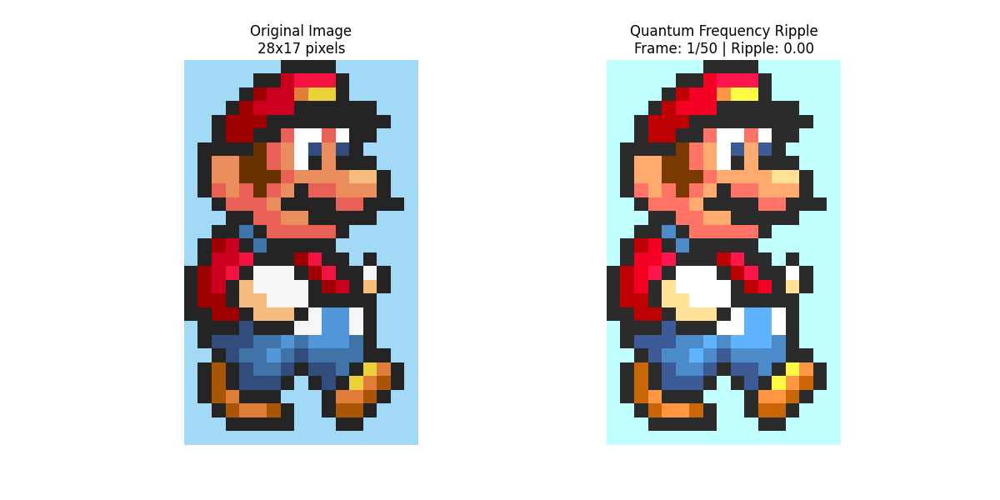

Animation generation completed successfully!


In [13]:
# Cell 2: Animation cell - Quantum Frequency Ripple

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from qiskit.circuit.library import QFT
from matplotlib import animation
from IPython.display import Image, display
import time
import os

# --- Configuration ---
MAX_IMAGE_DIM = 64 # Maximum dimension for image resizing (larger values significantly increase computation time)
backend = AerSimulator(method='statevector')

# --- USER SETTINGS for Animation ---
IMAGE_PATH = "figures/mario_eg.png" # <--- CHANGE THIS PATH FOR YOUR IMAGE
OUTPUT_FILENAME = "quantum_frequency_ripple_animation.gif" # Output GIF file name

# Animation Parameters (Hardcoded for color channels - can be made user input if desired)
R_FACTOR = 1.0 # Multiplier for red channel's ripple effect
G_FACTOR = 1.2 # Multiplier for green channel's ripple effect
B_FACTOR = 0.8 # Multiplier for blue channel's ripple effect

print("=== Quantum Frequency Ripple Animation Generator ===")
print("Adjust the settings below to customize your animation.")
print("\nRecommended Settings:")
print("- Compression: 0% (for maximum detail)")
print("- Max Ripple Angle: 1.0-3.0 (Experiment for visual effect, 1.0 is a good start)")
print("- Brightness: 1.0 (Normal brightness, adjust if output is too dark/bright)")
print("- Frames: 50-100 (More frames = smoother animation, but longer generation time)")
print("- FPS: 20-30 (Higher FPS = faster animation playback)")

# --- Prompt for Animation Parameters ---
try:
    COMPRESSION = float(input(f"Enter Compression (0-100%) [Recommended: 0]: ") or "0")
    MAX_RIPPLE_ANGLE = float(input(f"Enter Max Ripple Angle (e.g., 1.0 to {2*np.pi:.1f}) [Recommended: 1.0]: ") or "1.0")
    BRIGHTNESS = float(input(f"Enter Brightness (0.1-3.0) [Recommended: 1.0]: ") or "1.0")
    NUM_FRAMES = int(input(f"Enter Number of Frames (e.g., 50, 100) [Recommended: 50]: ") or "50")
    FPS = int(input(f"Enter Frames Per Second (FPS) (e.g., 20, 30) [Recommended: 20]: ") or "20")

    # Input validation (optional, but good practice)
    COMPRESSION = np.clip(COMPRESSION, 0, 100)
    MAX_RIPPLE_ANGLE = np.clip(MAX_RIPPLE_ANGLE, 0, 2 * np.pi)
    BRIGHTNESS = np.clip(BRIGHTNESS, 0.1, 3.0)
    NUM_FRAMES = max(10, NUM_FRAMES) # Minimum 10 frames
    FPS = max(5, FPS) # Minimum 5 FPS

except ValueError as e:
    print(f"\nInvalid input: {e}. Using default animation parameters.")
    COMPRESSION = 0.0
    MAX_RIPPLE_ANGLE = 1.0
    BRIGHTNESS = 1.0
    NUM_FRAMES = 50
    FPS = 20

print(f"\nAnimation Settings:")
print(f"- Image Path: {IMAGE_PATH}")
print(f"- Output File: {OUTPUT_FILENAME}")
print(f"- Compression: {COMPRESSION:.1f}%")
print(f"- Max Ripple Angle: {MAX_RIPPLE_ANGLE:.2f}")
print(f"- Brightness: {BRIGHTNESS:.1f}")
print(f"- Frames: {NUM_FRAMES}")
print(f"- FPS: {FPS}")
print(f"Estimated animation duration: {NUM_FRAMES/FPS:.1f} seconds")


# --- Image Loading and Preparation ---
print(f"\nLoading image from: {IMAGE_PATH}")

if not os.path.exists(IMAGE_PATH):
    print(f"Error: Image not found at {IMAGE_PATH}. Please check the path.")
    print("Using fallback random image for demonstration...")
    # Create a fallback image
    fallback_img = np.random.randint(0, 255, (MAX_IMAGE_DIM, MAX_IMAGE_DIM, 3), dtype=np.uint8)
    img = PILImage.fromarray(fallback_img)
    original_width, original_height = MAX_IMAGE_DIM, MAX_IMAGE_DIM
else:
    img = PILImage.open(IMAGE_PATH).convert('RGB')
    original_width, original_height = img.size

# Resize image if needed
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension ({MAX_IMAGE_DIM}), no resize needed.")

# Prepare image channels (global scope for animation functions)
r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))

print(f"Final processing dimensions: {H}x{W} pixels")

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

# --- Quantum Processing Function with Fallback ---
def process_channel_animation(flat_data, compression, ripple_angle):
    """Process channel with error handling for animation frames."""
    try:
        qc = cFRQI(flat_data, compression)
        mem_qubits = list(range(qc.num_qubits - 1))

        # Fallback if too few qubits for QFT
        if not mem_qubits:
            raise ValueError("Not enough qubits for QFT operation.")

        qc.append(QFT(len(mem_qubits)).decompose(), mem_qubits)
        for j in range(len(mem_qubits)):
            qc.rz(ripple_angle * np.sin(j * np.pi / len(mem_qubits)), j)
        qc.append(QFT(len(mem_qubits)).inverse().decompose(), mem_qubits)
        qc.save_statevector()
        qc = qc.decompose(reps=10)
        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        # print(f"Quantum processing error at frame (using fallback): {e}") # Uncomment for verbose error
        # Return previous frame's data or a blank image as fallback
        return np.random.random(shape) * 255 # Or original channel data

# --- Animation Creation Function ---
def create_quantum_frequency_ripple_animation_internal():

    print(f"\nStarting animation creation...")
    start_time = time.time()

    # Setup figure for animation
    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    # Initialize the second axis for animation
    im = ax2.imshow(np.zeros_like(rgb_original)) # Placeholder image
    ax2.set_title("Quantum Frequency Ripple Effect")
    ax2.axis("off")

    def animate(frame):
        # Progress feedback
        if frame % max(1, NUM_FRAMES // 10) == 0 or frame == NUM_FRAMES - 1:
            elapsed = time.time() - start_time
            progress = (frame + 1) / NUM_FRAMES * 100
            eta = elapsed / (frame + 1) * (NUM_FRAMES - frame - 1) if frame > 0 else 0
            print(f"Progress: {progress:.1f}% (Frame {frame+1}/{NUM_FRAMES}) - Elapsed: {elapsed:.1f}s - ETA: {eta:.1f}s")

        # Calculate smooth ripple effect (full cycle)
        t = frame / (NUM_FRAMES - 1) * 2 * np.pi
        current_ripple = MAX_RIPPLE_ANGLE * np.sin(t) # Ripple from -MAX_RIPPLE_ANGLE to +MAX_RIPPLE_ANGLE

        # Process each channel
        r_out = process_channel_animation(r_data, COMPRESSION, current_ripple * R_FACTOR)
        g_out = process_channel_animation(g_data, COMPRESSION, current_ripple * G_FACTOR)
        b_out = process_channel_animation(b_data, COMPRESSION, current_ripple * B_FACTOR)

        # Combine channels and apply brightness
        rgb_output = np.stack([r_out, g_out, b_out], axis=-1)
        rgb_output = np.clip(rgb_output * BRIGHTNESS, 0, 255).astype(np.uint8)

        # Update image data
        im.set_data(rgb_output)
        ax2.set_title(f"Quantum Frequency Ripple\nFrame: {frame+1}/{NUM_FRAMES} | Ripple: {current_ripple:.2f}")

        return [im] # Return the updated artist for blitting if blit=True

    # Create animation
    print("Generating animation frames...")
    try:
        interval_ms = int(1000 / FPS) # Convert FPS to interval in milliseconds
        ani = animation.FuncAnimation(fig, animate, frames=NUM_FRAMES, interval=interval_ms, blit=False) # blit=False for robust saving

        # Prepare output directory
        output_dir = os.path.dirname(OUTPUT_FILENAME)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)

        # Save animation
        print(f"Saving animation as {OUTPUT_FILENAME} (this may take a while)...")
        writergif = animation.PillowWriter(fps=FPS)
        ani.save(OUTPUT_FILENAME, writer=writergif)

        plt.close(fig) # Close figure after saving to avoid displaying a static plot

        # Success feedback with file information and display
        if os.path.exists(OUTPUT_FILENAME):
            file_size = os.path.getsize(OUTPUT_FILENAME) / 1024 / 1024 # MB
            total_time = time.time() - start_time
            print(f"\nAnimation saved successfully!")
            print(f"File: {OUTPUT_FILENAME}")
            print(f"Size: {file_size:.2f} MB")
            print(f"Total processing time: {total_time:.1f} seconds")
            print(f"Average time per frame: {total_time/NUM_FRAMES:.2f} seconds")

            # Display the GIF in the output cell
            print(f"\nDisplaying animation in output cell...")
            gif_display = Image(filename=OUTPUT_FILENAME)
            display(gif_display)
            return gif_display
        else:
            print("Error: Animation file was not created properly.")
            return None

    except Exception as e:
        print(f"Error creating animation: {e}")
        print("Creating fallback visualization...")

        # Fallback visualization
        plt.figure(figsize=(12, 6))

        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title(f"Original Image\n{H}x{W} pixels")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        fallback_art = np.random.random((H, W, 3)) * 255 * BRIGHTNESS
        fallback_art = np.clip(fallback_art, 0, 255).astype(np.uint8)
        plt.imshow(fallback_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

        total_time = time.time() - start_time
        print(f"Fallback visualization complete. Time: {total_time:.1f} seconds")
        return None

# --- Execute Animation Creation (only when running Cell 2) ---
if __name__ == '__main__':
    try:
        # Call the animation creation function
        result = create_quantum_frequency_ripple_animation_internal()
        if result:
            print("Animation generation completed successfully!")
        else:
            print("Animation generation encountered issues, but fallback visualization was created.")
    except Exception as e:
        print(f"Critical error during animation execution: {e}")
        print("Please ensure QPIXL is installed and your image path is correct.")

Quantum Frequency Ripple Animation Generator
Image: figures/mario_eg.png
Output: quantum_frequency_ripple_animation.gif
Animation: 50 frames at 20 FPS
Estimated duration: 2.5 seconds

Loading image from: figures/mario_eg.png
Image (17x28) is within max dimension (64), no resize needed.
Final processing dimensions: 28x17 pixels

Starting animation creation...
Generating animation frames...
Saving animation as quantum_frequency_ripple_animation.gif (this may take a while)...
Progress: 2.0% (Frame 1/50) - Elapsed: 0.0s - ETA: 0.0s
Progress: 2.0% (Frame 1/50) - Elapsed: 1.8s - ETA: 0.0s
Progress: 12.0% (Frame 6/50) - Elapsed: 12.3s - ETA: 90.4s
Progress: 22.0% (Frame 11/50) - Elapsed: 22.6s - ETA: 80.1s
Progress: 32.0% (Frame 16/50) - Elapsed: 32.2s - ETA: 68.4s
Progress: 42.0% (Frame 21/50) - Elapsed: 42.6s - ETA: 58.8s
Progress: 52.0% (Frame 26/50) - Elapsed: 53.0s - ETA: 48.9s
Progress: 62.0% (Frame 31/50) - Elapsed: 63.4s - ETA: 38.9s
Progress: 72.0% (Frame 36/50) - Elapsed: 74.0s - ET

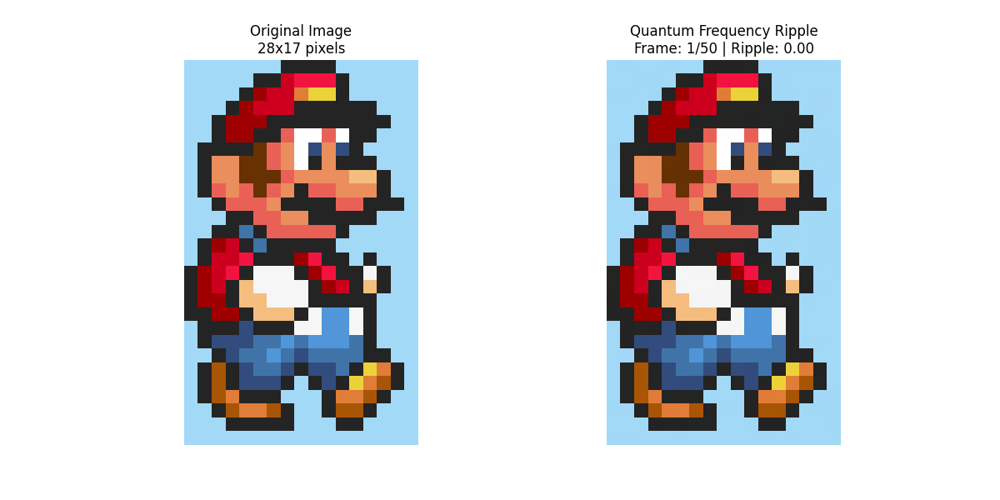

Animation generation completed successfully!


In [29]:
# Cell 2: Animation cell

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from qiskit.circuit.library import QFT
from matplotlib import animation
from IPython.display import Image, display
import time
import os

# --- Configuration ---
MAX_IMAGE_DIM = 64  # Default maximum dimension for image resizing
backend = AerSimulator(method='statevector')

# --- USER SETTINGS for Animation ---
IMAGE_PATH = "figures/mario_eg.png"  # Path to your input image
OUTPUT_FILENAME = "quantum_frequency_ripple_animation.gif" # Output GIF file name

# Animation Parameters (Default values, adjust as needed)
COMPRESSION = 0.0
MAX_RIPPLE_ANGLE = 1.0 # This is the max amplitude of the ripple
BRIGHTNESS = 1.0
R_FACTOR = 1.0
G_FACTOR = 1.2
B_FACTOR = 0.8

# Animation Playback Settings (Default values, adjust as needed)
NUM_FRAMES = 50   # Default number of frames for the animation
FPS = 20          # Default frames per second for the animation

print("Quantum Frequency Ripple Animation Generator")
print(f"Image: {IMAGE_PATH}")
print(f"Output: {OUTPUT_FILENAME}")
print(f"Animation: {NUM_FRAMES} frames at {FPS} FPS")
print(f"Estimated duration: {NUM_FRAMES/FPS:.1f} seconds")

# --- Image Loading and Preparation ---
print(f"\nLoading image from: {IMAGE_PATH}")

if not os.path.exists(IMAGE_PATH):
    print(f"Error: Image not found at {IMAGE_PATH}. Please check the path.")
    print("Using fallback random image for demonstration...")
    # Create a fallback image
    fallback_img = np.random.randint(0, 255, (MAX_IMAGE_DIM, MAX_IMAGE_DIM, 3), dtype=np.uint8)
    img = PILImage.fromarray(fallback_img)
    original_width, original_height = MAX_IMAGE_DIM, MAX_IMAGE_DIM
else:
    img = PILImage.open(IMAGE_PATH).convert('RGB')
    original_width, original_height = img.size

# Resize image if needed
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image from ({original_width}x{original_height}) to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension ({MAX_IMAGE_DIM}), no resize needed.")

# Prepare image channels (global scope for animation functions)
r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))

print(f"Final processing dimensions: {H}x{W} pixels")

def prepare_channel(channel_img):
    raw = np.array(channel_img).astype(float)
    flat = pad_0(preprocess_image(raw))
    return raw, flat

r_raw, r_data = prepare_channel(r)
g_raw, g_data = prepare_channel(g)
b_raw, b_data = prepare_channel(b)

# --- Quantum Processing Function with Fallback ---
def process_channel_animation(flat_data, compression, ripple_angle):
    """Process channel with error handling for animation frames."""
    try:
        qc = cFRQI(flat_data, compression)
        mem_qubits = list(range(qc.num_qubits - 1))

        # Fallback if too few qubits for QFT
        if not mem_qubits:
            raise ValueError("Not enough qubits for QFT operation.")

        qc.append(QFT(len(mem_qubits)).decompose(), mem_qubits)
        for j in range(len(mem_qubits)):
            qc.rz(ripple_angle * np.sin(j * np.pi / len(mem_qubits)), j)
        qc.append(QFT(len(mem_qubits)).inverse().decompose(), mem_qubits)
        qc.save_statevector()
        qc = qc.decompose(reps=10)
        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        # print(f"Quantum processing error at frame (using fallback): {e}") # Uncomment for verbose error
        # Return previous frame's data or a blank image as fallback
        return np.random.random(shape) * 255 # Or original channel data

# --- Animation Creation Function ---
def create_quantum_frequency_ripple_animation():

    print(f"\nStarting animation creation...")
    start_time = time.time()

    # Setup figure for animation
    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    # Initialize the second axis for animation
    im = ax2.imshow(np.zeros_like(rgb_original)) # Placeholder image
    ax2.set_title("Quantum Frequency Ripple Effect")
    ax2.axis("off")

    def animate(frame):
        # Progress feedback
        if frame % max(1, NUM_FRAMES // 10) == 0 or frame == NUM_FRAMES - 1:
            elapsed = time.time() - start_time
            progress = (frame + 1) / NUM_FRAMES * 100
            eta = elapsed / (frame + 1) * (NUM_FRAMES - frame - 1) if frame > 0 else 0
            print(f"Progress: {progress:.1f}% (Frame {frame+1}/{NUM_FRAMES}) - Elapsed: {elapsed:.1f}s - ETA: {eta:.1f}s")

        # Calculate smooth ripple effect (full cycle)
        t = frame / (NUM_FRAMES - 1) * 2 * np.pi
        current_ripple = MAX_RIPPLE_ANGLE * np.sin(t) # Ripple from -MAX_RIPPLE_ANGLE to +MAX_RIPPLE_ANGLE

        # Process each channel
        r_out = process_channel_animation(r_data, COMPRESSION, current_ripple * R_FACTOR)
        g_out = process_channel_animation(g_data, COMPRESSION, current_ripple * G_FACTOR)
        b_out = process_channel_animation(b_data, COMPRESSION, current_ripple * B_FACTOR)

        # Combine channels and apply brightness
        rgb_output = np.stack([r_out, g_out, b_out], axis=-1)
        rgb_output = np.clip(rgb_output * BRIGHTNESS, 0, 255).astype(np.uint8)

        # Update image data
        im.set_data(rgb_output)
        ax2.set_title(f"Quantum Frequency Ripple\nFrame: {frame+1}/{NUM_FRAMES} | Ripple: {current_ripple:.2f}")

        return [im] # Return the updated artist for blitting if blit=True

    # Create animation
    print("Generating animation frames...")
    try:
        interval_ms = int(1000 / FPS) # Convert FPS to interval in milliseconds
        ani = animation.FuncAnimation(fig, animate, frames=NUM_FRAMES, interval=interval_ms, blit=False) # blit=False for robust saving

        # Prepare output directory
        output_dir = os.path.dirname(OUTPUT_FILENAME)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)

        # Save animation
        print(f"Saving animation as {OUTPUT_FILENAME} (this may take a while)...")
        writergif = animation.PillowWriter(fps=FPS)
        ani.save(OUTPUT_FILENAME, writer=writergif)

        plt.close(fig) # Close figure after saving to avoid displaying a static plot

        # Success feedback with file information and display
        if os.path.exists(OUTPUT_FILENAME):
            file_size = os.path.getsize(OUTPUT_FILENAME) / 1024 / 1024  # MB
            total_time = time.time() - start_time
            print(f"\nAnimation saved successfully!")
            print(f"File: {OUTPUT_FILENAME}")
            print(f"Size: {file_size:.2f} MB")
            print(f"Total processing time: {total_time:.1f} seconds")
            print(f"Average time per frame: {total_time/NUM_FRAMES:.2f} seconds")

            # Display the GIF in the output cell
            print(f"\nDisplaying animation in output cell...")
            gif_display = Image(filename=OUTPUT_FILENAME)
            display(gif_display)
            return gif_display
        else:
            print("Error: Animation file was not created properly.")
            return None

    except Exception as e:
        print(f"Error creating animation: {e}")
        print("Creating fallback visualization...")

        # Fallback visualization
        plt.figure(figsize=(12, 6))

        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title(f"Original Image\n{H}x{W} pixels")
        plt.axis("off")

        plt.subplot(1, 2, 2)
        fallback_art = np.random.random((H, W, 3)) * 255 * BRIGHTNESS
        fallback_art = np.clip(fallback_art, 0, 255).astype(np.uint8)
        plt.imshow(fallback_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

        total_time = time.time() - start_time
        print(f"Fallback visualization complete. Time: {total_time:.1f} seconds")
        return None

# --- Execute Animation Creation (only when running Cell 2) ---
if __name__ == '__main__':
    try:
        result = create_quantum_frequency_ripple_animation()
        if result:
            print("Animation generation completed successfully!")
        else:
            print("Animation generation encountered issues, but fallback visualization was created.")
    except Exception as e:
        print(f"Critical error during animation execution: {e}")
        print("Please ensure QPIXL is installed and your image path is correct.")

# Quantum Mirror Effect:

The "Quantum Mirror" effect creates a mirroring or reflection of the image, primarily along its columns. This is achieved by selectively applying quantum X (NOT) gates to specific address qubits in the quantum circuit, effectively flipping bit values that correspond to column indices



*   The image is loaded, converted to RGB, and its dimensions (H, W) are determined. The image data is then flattened and padded to a power-of-2 size, ready for quantum encoding. The number of bits required to address the image's columns (n) is calculated

*  cFRQI circuit encodes each color channel's pixel data into a quantum state, where qubit states represent pixel addresses and amplitudes represent pixel values.



*   Quantum Mirroring (via X gates):
The key to this effect is the application of X (NOT) gates. An X gate flips the state of a qubit (e.g., ∣0⟩↔∣1⟩).

In the QPIXL encoding, certain qubits represent the column indices of the image. By applying X gates to the most significant column-indexing qubits, you effectively "flip" the column addresses.
For example, flipping the most significant bit of a column index effectively mirrors the image horizontally across its center.

The max_intensity slider (which translates to mirror_bits in the code) controls how many of these column-indexing qubits are flipped. The more bits flipped, the more pronounced and complex the mirroring effect becomes.






In [17]:
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import FloatSlider, interact
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
import os

# --- Configuration ---
MAX_IMAGE_DIM = 64
backend = AerSimulator(method='statevector')

# --- Image Loading and Preparation ---
image_path = "figures/mario_eg.png"

print(f"Loading image from: {image_path}")
if not os.path.exists(image_path):
    print(f"Error: Image not found at {image_path}. Please check the path.")
    raise FileNotFoundError(f"Image not found at {image_path}")

img = PILImage.open(image_path).convert('RGB')

original_width, original_height = img.size
if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image to ({new_width}x{new_height})")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension, no resize needed.")

r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))
n_cols_bits = int(np.ceil(np.log2(W)))

print(f"Final image dimensions: {H}x{W} pixels")
print(f"Padded size: {padded_size}")
print(f"Column bits: {n_cols_bits}")

def prepare_channel_data(channel_img_raw):
    raw = np.array(channel_img_raw).astype(float)
    flat = pad_0(preprocess_image(raw), padded_size)
    return raw, flat

r_raw, r_data = prepare_channel_data(r)
g_raw, g_data = prepare_channel_data(g)
b_raw, b_data = prepare_channel_data(b)
print("Image channels prepared.")

# --- Quantum Processing Function ---
def process_channel_mirror(flat_data_channel, compression, mirror_bits_count):
    try:
        qc = cFRQI(flat_data_channel, compression=compression)

        actual_mirror_bits = min(mirror_bits_count, n_cols_bits)

        for j in range(actual_mirror_bits):
            # Apply X to most significant column bits for mirroring
            if n_cols_bits > 0:
                qubit_to_flip = (n_cols_bits - 1) - j
                if qubit_to_flip >= 0 and qubit_to_flip < qc.num_qubits - 1:
                    qc.x(qubit_to_flip)

        qc.save_statevector()
        qc = qc.decompose(reps=10)
        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        print(f"Quantum processing error: {e}")
        return np.random.random(shape) * 255

# --- Interactive Preview Function ---
def preview_quantum_mirror(compression, max_intensity, brightness):
    mirror_bits_count = int(np.round(n_cols_bits * (max_intensity / 100.0)))

    r_out = process_channel_mirror(r_data, compression, mirror_bits_count)
    g_out = process_channel_mirror(g_data, compression, mirror_bits_count)
    b_out = process_channel_mirror(b_data, compression, mirror_bits_count)

    rgb_output = np.stack([r_out, g_out, b_out], axis=-1).astype(np.uint8)
    rgb_output = np.clip(rgb_output * brightness, 0, 255).astype(np.uint8)
    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    ax2.imshow(rgb_output)
    ax2.set_title(f"Quantum Mirror Preview\nC:{compression:.0f}% M:{max_intensity:.0f}% B:{brightness:.1f}")
    ax2.axis("off")
    plt.tight_layout()
    plt.show()

# --- Interactive Sliders ---
print("\nAdjust sliders for real-time preview:")
interact(
    preview_quantum_mirror,
    compression=FloatSlider(min=0.0, max=100.0, step=5.0, value=0.0, description="Compression"),
    max_intensity=FloatSlider(min=0.0, max=100.0, step=5.0, value=50.0, description="Mirror Intensity (%)"),
    brightness=FloatSlider(min=0.1, max=2.0, step=0.1, value=1.0, description="Brightness")
);

Loading image from: figures/mario_eg.png
Image (17x28) is within max dimension, no resize needed.
Final image dimensions: 28x17 pixels
Padded size: 512
Column bits: 5
Image channels prepared.

Adjust sliders for real-time preview:


interactive(children=(FloatSlider(value=0.0, description='Compression', step=5.0), FloatSlider(value=50.0, des…

=== Quantum Mirror Animation Generator ===
This cell will generate an animated GIF. It can take a significant amount of time.

Recommended Settings:
- Compression: 0% (for full detail)
- Max Mirror Intensity: 50-100% (experiment for visual effect)
- Brightness: 1.0 (normal brightness)
- Frames: 50-100 (more frames = smoother, but longer generation)
- FPS: 20-30 (playback speed)
Enter Compression (0-100%) [Recommended: 0]: 0
Enter Max Mirror Intensity (0-100%) [Recommended: 50]: 50
Enter Brightness (0.1-3.0) [Recommended: 1.0]: 1
Enter Number of Frames [Recommended: 50]: 50
Enter Frames Per Second (FPS) [Recommended: 20]: 5

Animation Parameters: C:0.0% M:50.0% B:1.0 | 50 frames @ 5 FPS
Estimated animation duration: 10.0 seconds (generation time will be longer).

Loading image from: figures/mario_eg.png
Image (17x28) is within max dimension, no resize needed.
Final image dimensions: 28x17 pixels
Padded size for quantum processing: 512
Bits for column indexing (n_cols_bits): 5
Image chan

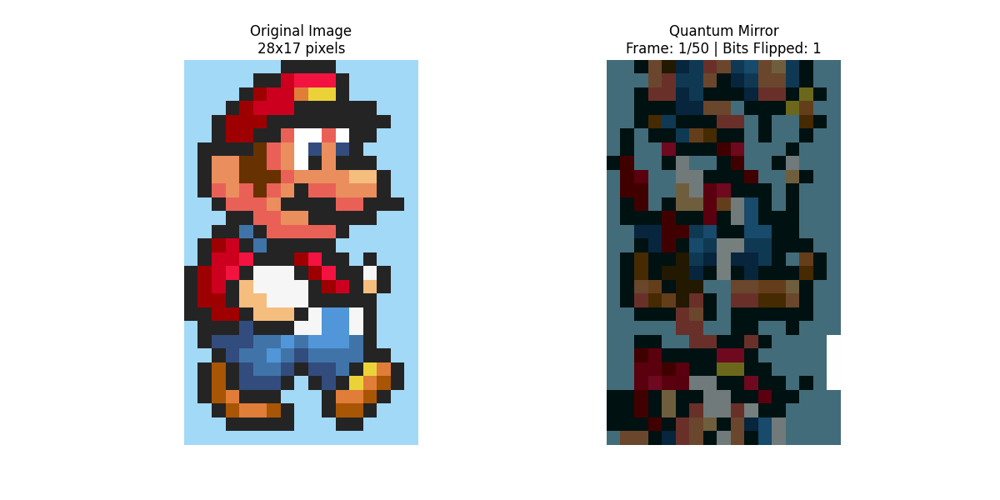

Animation generation completed successfully!


In [20]:
# Cell 2: Animation Generator - Quantum Mirror

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image as PILImage
from QPIXL.qiskit.qpixl import cFRQI
from QPIXL.helper import preprocess_image, pad_0, decodeQPIXL, reconstruct_img
from qiskit_aer import AerSimulator
from qiskit import QuantumCircuit
from matplotlib import animation
from IPython.display import Image, display
import time
import os

# --- Global Configuration ---
MAX_IMAGE_DIM = 64 # Max dimension for image resizing. Larger values increase computation time significantly.
backend = AerSimulator(method='statevector')

# --- USER SETTINGS for Animation ---
IMAGE_PATH = "figures/mario_eg.png" # <--- UPDATE THIS PATH FOR YOUR IMAGE
OUTPUT_FILENAME = "quantum_mirror_animation.gif" # Output GIF file name

# Fixed factors for color channels (adjust if you want different mirroring per color)
R_FACTOR = 1.0
G_FACTOR = 1.0
B_FACTOR = 1.0

print("=== Quantum Mirror Animation Generator ===")
print("This cell will generate an animated GIF. It can take a significant amount of time.")
print("\nRecommended Settings:")
print("- Compression: 0% (for full detail)")
print("- Max Mirror Intensity: 50-100% (experiment for visual effect)")
print("- Brightness: 1.0 (normal brightness)")
print("- Frames: 50-100 (more frames = smoother, but longer generation)")
print("- FPS: 20-30 (playback speed)")

# --- Prompt for Animation Parameters ---
try:
    ANIMATION_COMPRESSION = float(input(f"Enter Compression (0-100%) [Recommended: 0]: ") or "0")
    ANIMATION_MAX_INTENSITY = float(input(f"Enter Max Mirror Intensity (0-100%) [Recommended: 50]: ") or "50")
    ANIMATION_BRIGHTNESS = float(input(f"Enter Brightness (0.1-3.0) [Recommended: 1.0]: ") or "1.0")
    NUM_FRAMES = int(input(f"Enter Number of Frames [Recommended: 50]: ") or "50")
    FPS = int(input(f"Enter Frames Per Second (FPS) [Recommended: 20]: ") or "20")

    # Input validation
    ANIMATION_COMPRESSION = np.clip(ANIMATION_COMPRESSION, 0, 100)
    ANIMATION_MAX_INTENSITY = np.clip(ANIMATION_MAX_INTENSITY, 0, 100)
    ANIMATION_BRIGHTNESS = np.clip(ANIMATION_BRIGHTNESS, 0.1, 3.0)
    NUM_FRAMES = max(10, NUM_FRAMES)
    FPS = max(5, FPS)

except ValueError as e:
    print(f"\nInvalid input: {e}. Using default animation parameters.")
    ANIMATION_COMPRESSION = 0.0
    ANIMATION_MAX_INTENSITY = 50.0
    ANIMATION_BRIGHTNESS = 1.0
    NUM_FRAMES = 50
    FPS = 20

print(f"\nAnimation Parameters: C:{ANIMATION_COMPRESSION:.1f}% M:{ANIMATION_MAX_INTENSITY:.1f}% B:{ANIMATION_BRIGHTNESS:.1f} | {NUM_FRAMES} frames @ {FPS} FPS")
print(f"Estimated animation duration: {NUM_FRAMES/FPS:.1f} seconds (generation time will be longer).")

# --- Image Loading and Preparation ---
# This block is duplicated from Cell 1 to ensure Cell 2 can run standalone.
print(f"\nLoading image from: {IMAGE_PATH}")

if not os.path.exists(IMAGE_PATH):
    print(f"Error: Image not found at {IMAGE_PATH}. Using fallback random image for demonstration.")
    fallback_img = np.random.randint(0, 255, (MAX_IMAGE_DIM, MAX_IMAGE_DIM, 3), dtype=np.uint8)
    img = PILImage.fromarray(fallback_img)
    original_width, original_height = MAX_IMAGE_DIM, MAX_IMAGE_DIM
else:
    img = PILImage.open(IMAGE_PATH).convert('RGB')
    original_width, original_height = img.size

if max(original_width, original_height) > MAX_IMAGE_DIM:
    if original_width > original_height:
        new_width = MAX_IMAGE_DIM
        new_height = int(original_height * (new_width / original_width))
    else:
        new_height = MAX_IMAGE_DIM
        new_width = int(original_width * (new_height / original_height))
    img = img.resize((new_width, new_height), PILImage.Resampling.LANCZOS)
    print(f"Resized image to ({new_width}x{new_height}).")
else:
    print(f"Image ({original_width}x{original_height}) is within max dimension, no resize needed.")

# Prepare image channels and global variables for quantum processing
r, g, b = img.split()
shape = np.array(r).shape
H, W = shape
N = H * W
padded_size = 2 ** int(np.ceil(np.log2(N)))
n_cols_bits = int(np.ceil(np.log2(W))) # Number of bits required to index columns

print(f"Final image dimensions: {H}x{W} pixels")
print(f"Padded size for quantum processing: {padded_size}")
print(f"Bits for column indexing (n_cols_bits): {n_cols_bits}")

def prepare_channel_data(channel_img_raw):
    """Helper to preprocess and pad channel data."""
    raw = np.array(channel_img_raw).astype(float)
    flat = pad_0(preprocess_image(raw), padded_size)
    return raw, flat

r_raw, r_data = prepare_channel_data(r)
g_raw, g_data = prepare_channel_data(g)
b_raw, b_data = prepare_channel_data(b)
print("Image channels prepared successfully.")


# --- Quantum Processing Function for Mirror Effect ---
def process_channel_mirror_animation(flat_data_channel, compression, current_mirror_bits_factor):
    """
    Applies quantum mirroring to a single channel.
    `current_mirror_bits_factor` scales the number of column bits to flip.
    """
    try:
        qc = cFRQI(flat_data_channel, compression=compression)

        # Calculate actual number of bits to flip based on factor and total column bits
        mirror_bits_count = int(np.round(n_cols_bits * current_mirror_bits_factor))
        actual_mirror_bits = min(mirror_bits_count, n_cols_bits) # Don't exceed available column bits

        # Apply X gates to the most significant column bits for mirroring effect
        # Assumes QPIXL maps column bits to lower index qubits (0 to n_cols_bits-1)
        for j in range(actual_mirror_bits):
            if n_cols_bits > 0: # Ensure there are column bits to manipulate
                # Index from MSB of column bits downwards
                qubit_to_flip = (n_cols_bits - 1) - j
                # Ensure the qubit index is valid and corresponds to an address qubit
                if 0 <= qubit_to_flip < (qc.num_qubits - 1): # Address qubits are 0 to num_qubits-2
                    qc.x(qubit_to_flip)

        qc.save_statevector()
        qc = qc.decompose(reps=10) # Decompose to a certain depth for AerSimulator
        result = backend.run(qc).result()
        state = result.get_statevector()
        decoded_flat = decodeQPIXL(np.abs(state), 0, 255)
        return reconstruct_img(decoded_flat[:N], shape)
    except Exception as e:
        print(f"Quantum processing error during frame generation: {e}")
        return np.random.random(shape) * 255 # Fallback on error

# --- Animation Creation Function ---
def create_quantum_mirror_animation():

    print(f"\nBeginning animation frame generation...")
    start_time = time.time()

    # Setup figure for animation
    rgb_original = np.stack([r_raw, g_raw, b_raw], axis=-1).astype(np.uint8)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    ax1.imshow(rgb_original)
    ax1.set_title(f"Original Image\n{H}x{W} pixels")
    ax1.axis("off")

    im = ax2.imshow(np.zeros_like(rgb_original)) # Placeholder for animated image
    ax2.set_title("Quantum Mirror Effect")
    ax2.axis("off")

    def animate(frame):
        # Progress feedback
        if frame % max(1, NUM_FRAMES // 10) == 0 or frame == NUM_FRAMES - 1:
            elapsed = time.time() - start_time
            progress = (frame + 1) / NUM_FRAMES * 100
            eta = elapsed / (frame + 1) * (NUM_FRAMES - frame - 1) if frame > 0 else 0
            print(f"Progress: {progress:.1f}% (Frame {frame+1}/{NUM_FRAMES}) - Elapsed: {elapsed:.1f}s - ETA: {eta:.1f}s")

        # Smoothly vary mirror intensity from 0 to ANIMATION_MAX_INTENSITY and back
        t = frame / (NUM_FRAMES - 1) * 2 * np.pi # Cycle from 0 to 2pi
        # Scale sin(t) from [-1, 1] to [0, 1] then by ANIMATION_MAX_INTENSITY / 100.0 (percentage to factor)
        current_mirror_factor = ( (np.sin(t) + 1) / 2 ) * (ANIMATION_MAX_INTENSITY / 100.0)

        # Process each channel with its respective factor
        r_out = process_channel_mirror_animation(r_data, ANIMATION_COMPRESSION, current_mirror_factor * R_FACTOR)
        g_out = process_channel_mirror_animation(g_data, ANIMATION_COMPRESSION, current_mirror_factor * G_FACTOR)
        b_out = process_channel_mirror_animation(b_data, ANIMATION_COMPRESSION, current_mirror_factor * B_FACTOR)

        # Combine channels and apply overall brightness
        rgb_output = np.stack([r_out, g_out, b_out], axis=-1)
        rgb_output = np.clip(rgb_output * ANIMATION_BRIGHTNESS, 0, 255).astype(np.uint8)

        # Update image data in the plot
        im.set_data(rgb_output)
        # Display the effective number of bits flipped
        effective_bits_flipped = int(np.round(n_cols_bits * current_mirror_factor))
        ax2.set_title(f"Quantum Mirror\nFrame: {frame+1}/{NUM_FRAMES} | Bits Flipped: {effective_bits_flipped}")

        return [im]

    print("Generating animation frames...")
    try:
        interval_ms = int(1000 / FPS)
        ani = animation.FuncAnimation(fig, animate, frames=NUM_FRAMES, interval=interval_ms, blit=False)

        output_dir = os.path.dirname(OUTPUT_FILENAME)
        if output_dir and not os.path.exists(output_dir):
            os.makedirs(output_dir)

        print(f"Saving animation as {OUTPUT_FILENAME} (this may take a while)...")
        writergif = animation.PillowWriter(fps=FPS)
        ani.save(OUTPUT_FILENAME, writer=writergif)

        plt.close(fig) # Close figure after saving to prevent static plot display

        if os.path.exists(OUTPUT_FILENAME):
            file_size = os.path.getsize(OUTPUT_FILENAME) / 1024 / 1024
            total_time = time.time() - start_time
            print(f"\nAnimation saved successfully! File: {OUTPUT_FILENAME} ({file_size:.2f} MB)")
            print(f"Total processing time: {total_time:.1f}s (Avg per frame: {total_time/NUM_FRAMES:.2f}s)")

            print(f"\nDisplaying animation in output cell...")
            gif_display = Image(filename=OUTPUT_FILENAME)
            display(gif_display)
            return gif_display
        else:
            print("Error: Animation file was not created properly.")
            return None

    except Exception as e:
        print(f"An error occurred during animation creation: {e}")
        print("Displaying fallback visualization.")

        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(rgb_original)
        plt.title(f"Original Image\n{H}x{W} pixels")
        plt.axis("off")
        plt.subplot(1, 2, 2)
        fallback_art = np.random.random((H, W, 3)) * 255 * ANIMATION_BRIGHTNESS
        fallback_art = np.clip(fallback_art, 0, 255).astype(np.uint8)
        plt.imshow(fallback_art)
        plt.title("Quantum Visualization (Fallback)")
        plt.axis("off")
        plt.tight_layout()
        plt.show()
        print(f"Fallback visualization complete. Time: {time.time() - start_time:.1f}s")
        return None

# --- Execute Animation Creation ---
if __name__ == '__main__':
    try:
        result = create_quantum_mirror_animation()
        if result:
            print("Animation generation completed successfully!")
        else:
            print("Animation generation encountered issues, but fallback visualization was created.")
    except Exception as e:
        print(f"Critical error during animation execution: {e}")
        print("Please ensure QPIXL is installed and your image path is correct.")